# Force-200: MICE (max_iter=10), EDA

In [1]:
# import libraries
import numpy as np
import pandas as pd
import json

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.gridspec as gridspec
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import missingno as msno

from sklearn.preprocessing import LabelEncoder

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# 1. Data Pre-processing

In [2]:
# force train dataset
train = pd.read_csv(filepath_or_buffer='force_train.csv', sep=';')

# force test dataset
test = pd.read_csv(filepath_or_buffer='force_test.csv', sep=';')


In [3]:
# rename columns
train.rename(columns={'WELL': 'WELL_ID', 
                      'DEPTH_MD': 'DEPTH',
                      'X_LOC' : 'X',
                      'Y_LOC': 'Y', 
                      'GROUP': 'STRAT'
                     }, inplace=True
            )

test.rename(columns={'WELL': 'WELL_ID', 
                     'DEPTH_MD': 'DEPTH',
                     'X_LOC' : 'X',
                     'Y_LOC': 'Y', 
                     'GROUP': 'STRAT'
                    }, inplace=True
               )

In [4]:
# drop columns
train.drop(['Z_LOC', 'CALI', 'SGR', 'BS', 'ROP', 
            'DCAL', 'MUDWEIGHT', 'RMIC','ROPA', 'RXO', 
            'FORCE_2020_LITHOFACIES_LITHOLOGY',
            'FORCE_2020_LITHOFACIES_CONFIDENCE'], axis=1, inplace=True)

test.drop(['Z_LOC', 'CALI', 'SGR', 'BS', 'ROP', 
            'DCAL', 'MUDWEIGHT', 'RMIC','ROPA', 'RXO', 
            'FORCE_2020_LITHOFACIES_LITHOLOGY',
            'FORCE_2020_LITHOFACIES_CONFIDENCE'], axis=1, inplace=True)

In [5]:
# create a new column to store log base 10 of resistivity
# train
train['RD10'] = np.log10(train['RDEP']+1)
train['RM10'] = np.log10(train['RMED']+1)
train['RS10'] = np.log10(train['RSHA']+1)

# test
test['RD10'] = np.log10(test['RDEP']+1)
test['RM10'] = np.log10(test['RMED']+1)
test['RS10'] = np.log10(test['RSHA']+1)

In [6]:
# label encoding for well id
well_encoder = LabelEncoder()
well_encoder.fit(pd.concat([train, test]).WELL_ID.replace(np.nan, ''))

train['WELL'] = well_encoder.transform(train.WELL_ID.replace(np.nan, ''))
train['WELL'] = train['WELL'].astype(int)

test['WELL'] = well_encoder.transform(test.WELL_ID.replace(np.nan, ''))
test['WELL'] = test['WELL'].astype(int)


In [7]:
# feature selection
selected_features = ['WELL', 'X_LOC', 'Y_LOC', 'DEPTH',
                     'RHOB', 'GR', 'DTC', 'DTS',
                     'RD10', 'RM10', 'RS10',
                     'SP', 'NPHI','PEF',
                     'STRAT_ENCODED']

## 2. Results

In [8]:
well_logs = ['RHOB', 'GR', 'DTC', 'DTS', 
             'RD10', 'RM10', 'RS10', 
             'SP', 'NPHI']

### Training: Cross-Validation

In [9]:
# knr
with open('train_results_knr.txt', 'r') as f:
    train_results_knr = json.load(f)

# br
with open('train_results_br.txt', 'r') as f:
    train_results_br = json.load(f)

# rf
with open('train_results_rf.txt', 'r') as f:
    train_results_rf = json.load(f)
    
# xgb
with open('train_results_xgb.txt', 'r') as f:
    train_results_xgb = json.load(f)

In [10]:
def compare_well_logs(results, well_logs):
    metrics = list(results.keys())  
    data = []
    
    for i, metric in enumerate(metrics):
        average_values = [np.mean(results[metric][log]) for log in well_logs]
        data.append(average_values)
    
    df = pd.DataFrame(data, index=metrics, columns=well_logs)
    display(df)
    return df

train_knr = compare_well_logs(results=train_results_knr, well_logs=well_logs)
train_br = compare_well_logs(results=train_results_br, well_logs=well_logs)
train_rf = compare_well_logs(results=train_results_rf, well_logs=well_logs)
train_xgb = compare_well_logs(results=train_results_xgb, well_logs=well_logs)


,RHOB,GR,DTC,DTS,RD10,RM10,RS10,SP,NPHI
R2,-0.102128,-1.299555,0.395194,-0.193255,0.408584,0.537373,-0.602989,-8.265260e+26,-0.058225
MAE,0.039916,0.026588,0.033339,0.034896,0.028478,0.025408,0.050353,4.665950e-02,0.064153
MSE,0.003627,0.001347,0.002394,0.003461,0.003909,0.002868,0.008781,5.619847e-03,0.008157


,RHOB,GR,DTC,DTS,RD10,RM10,RS10,SP,NPHI
R2,-0.235828,-1.022065,0.020537,-1.181892,0.261283,0.520181,-0.519560,-1.278322e+27,-0.006953
MAE,0.046036,0.024947,0.043171,0.041774,0.030394,0.026136,0.050810,4.111458e-02,0.062312
MSE,0.004504,0.001277,0.003696,0.003874,0.004269,0.002815,0.008952,4.386507e-03,0.007759


,RHOB,GR,DTC,DTS,RD10,RM10,RS10,SP,NPHI
R2,0.172724,-0.663941,0.492489,0.274124,0.599411,0.570581,-0.380546,-1.032902e+27,0.197420
MAE,0.035336,0.023411,0.030230,0.029402,0.022952,0.021797,0.042495,4.138954e-02,0.055681
MSE,0.002863,0.001061,0.002139,0.003221,0.002869,0.002848,0.006937,4.414396e-03,0.006165


,RHOB,GR,DTC,DTS,RD10,RM10,RS10,SP,NPHI
R2,0.117213,-0.807995,0.538482,0.289851,0.542755,0.561874,-0.572851,-1.111905e+27,0.112356
MAE,0.035723,0.023596,0.029591,0.028986,0.023340,0.021840,0.044353,5.037968e-02,0.057196
MSE,0.002909,0.001082,0.001956,0.002615,0.003167,0.002816,0.007424,6.847426e-03,0.006442


In [11]:
train_results = {'KNR': train_knr,
                 'BR': train_br,
                 'RF': train_rf,
                 'XGB': train_xgb
                }

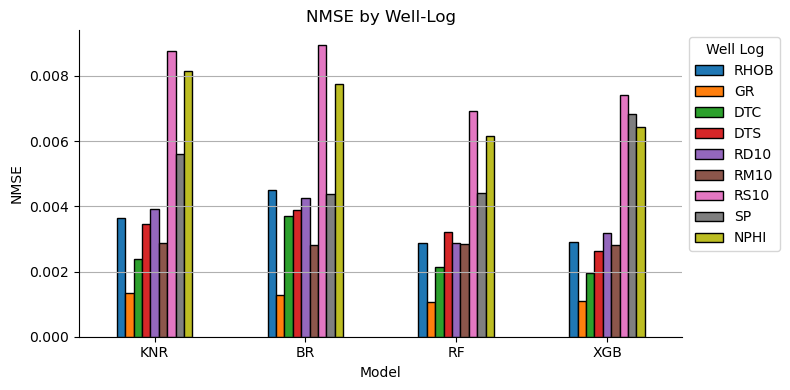

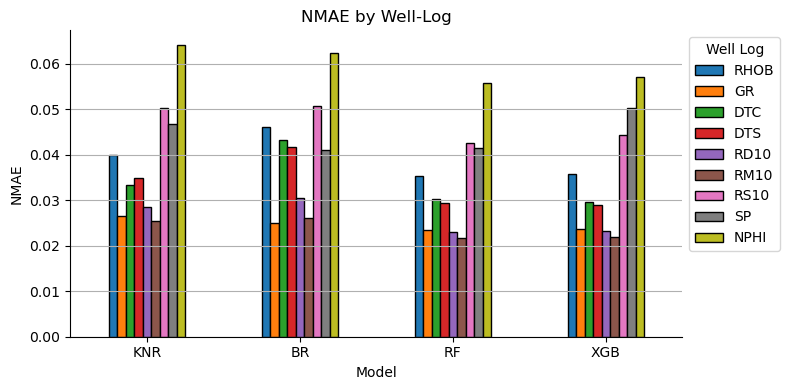

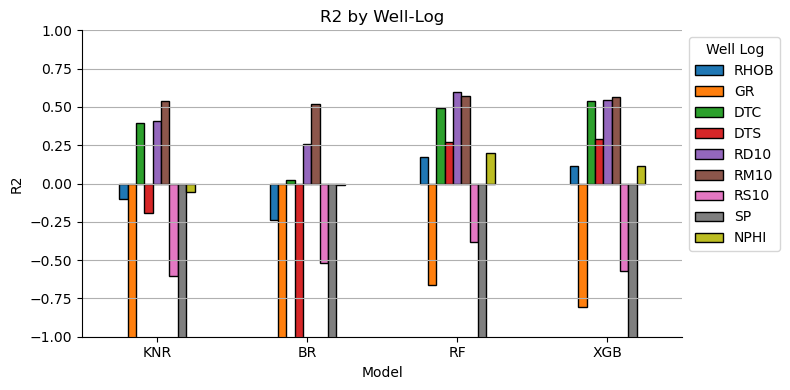

In [12]:
# NMSE - normalized mean squared error

metric = 'MSE'

model_data = []

for model_name, model_df in train_results.items():
    metric_values = model_df.loc[metric]
    model_data.append(metric_values)

df = pd.DataFrame(model_data, index=train_results.keys(), columns=well_logs)

ax = df.plot(kind='bar', figsize=(8, 4), edgecolor='black')

plt.title(f'N{metric} by Well-Log')
plt.xlabel('Model')
plt.ylabel('NMSE')

plt.xticks(rotation='horizontal')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.grid(True)
ax.legend(title='Well Log', bbox_to_anchor=(1, 1))

# ax.set_ylim([0, 0.1])

plt.tight_layout() 
plt.show()


# NMAE - normalized absolute error

metric = 'MAE'

model_data = []

for model_name, model_df in train_results.items():
    metric_values = model_df.loc[metric]
    model_data.append(metric_values)

df = pd.DataFrame(model_data, index=train_results.keys(), columns=well_logs)

ax = df.plot(kind='bar', figsize=(8, 4), edgecolor='black')

plt.title(f'N{metric} by Well-Log')
plt.xlabel('Model')
plt.ylabel('NMAE')

plt.xticks(rotation='horizontal')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.grid(True)
ax.legend(title='Well Log', bbox_to_anchor=(1, 1))

# ax.set_ylim([-1, 1])

plt.tight_layout() 
plt.show()



# R2

metric = 'R2'

model_data = []

for model_name, model_df in train_results.items():
    metric_values = model_df.loc[metric]
    model_data.append(metric_values)

df = pd.DataFrame(model_data, index=train_results.keys(), columns=well_logs)

ax = df.plot(kind='bar', figsize=(8, 4), edgecolor='black')

plt.title(f'{metric} by Well-Log')
plt.xlabel('Model')
plt.ylabel(metric)

plt.xticks(rotation='horizontal')

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.grid(True)
ax.legend(title='Well Log', bbox_to_anchor=(1, 1))

ax.set_ylim([-1, 1])

plt.tight_layout() 
plt.show()

In [13]:
# time in seconds of cross-validation
train_time = {'KNR': 22665.23,
              'BR': 138.60,
              'RF': 45745.36,
              'XGB': 14835.80
             }

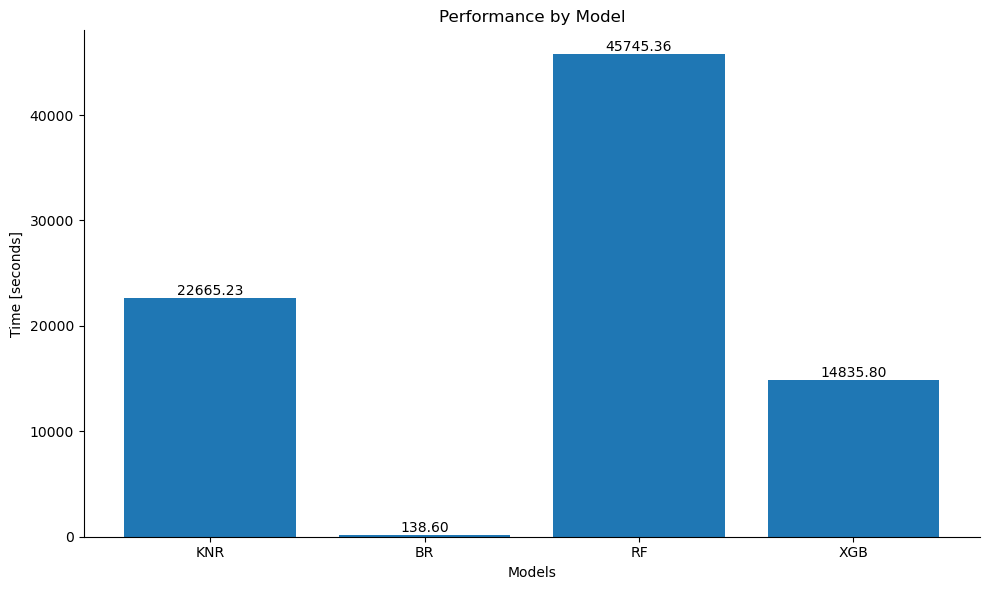

In [14]:
time_df = pd.DataFrame.from_dict(train_time, orient='index', columns=['Time'])

fig, axes = plt.subplots(figsize=(10, 6))

axes.bar(time_df.index, time_df['Time'])
axes.set_ylabel('Time [seconds]')
axes.set_xlabel('Models')
axes.set_title('Performance by Model')
axes.spines['top'].set_visible(False)
axes.spines['right'].set_visible(False)
for value in axes.containers:
    axes.bar_label(value, fmt='%.2f', label_type='edge')
plt.grid(False)
plt.tight_layout()
plt.show()


### Test

In [15]:
# results from mice
test_result_knr = pd.read_csv('test_result_knr.csv').add_suffix('_KNR')
test_result_br = pd.read_csv('test_result_br.csv').add_suffix('_BR')
test_result_rf = pd.read_csv('test_result_rf.csv').add_suffix('_RF')
test_result_xgb = pd.read_csv('test_result_xgb.csv').add_suffix('_XGB')

In [16]:
test_df = test.copy()
test_df.reset_index(drop=True, inplace=True)

# merge mice results with the test data
test_df = test_df.merge(test_result_knr, left_index=True, right_index=True)
test_df = test_df.merge(test_result_br, left_index=True, right_index=True)
test_df = test_df.merge(test_result_rf, left_index=True, right_index=True)
test_df = test_df.merge(test_result_xgb, left_index=True, right_index=True)

In [17]:
test_df

,WELL_ID,DEPTH,X,Y,STRAT,FORMATION,RSHA,RMED,RDEP,RHOB,...,NPHI_IMP_SCALED_XGB,RHOB_IMP_XGB,GR_IMP_XGB,DTC_IMP_XGB,DTS_IMP_XGB,RD10_IMP_XGB,RM10_IMP_XGB,RS10_IMP_XGB,SP_IMP_XGB,NPHI_IMP_XGB
0,15/9-23,1518.2800,433906.7500,6460000.5,HORDALAND GP.,Skade Fm.,NaN,NaN,0.878615,NaN,...,0.450773,2.007974,65.887908,126.746716,401.580802,0.315383,0.261232,NaN,NaN,0.430904
1,15/9-23,1518.4320,433906.7500,6460000.5,HORDALAND GP.,Skade Fm.,NaN,NaN,0.874237,NaN,...,0.453336,1.949271,62.781096,131.090151,410.249560,0.380681,0.258965,NaN,NaN,0.433558
2,15/9-23,1518.5840,433906.7500,6460000.5,HORDALAND GP.,Skade Fm.,NaN,NaN,0.869858,NaN,...,0.450794,1.948471,62.781096,131.296989,411.412420,0.363566,0.263754,NaN,NaN,0.430926
3,15/9-23,1518.7360,433906.7500,6460000.5,HORDALAND GP.,Skade Fm.,NaN,NaN,0.865479,NaN,...,0.454517,1.975742,78.999637,132.770965,402.277599,0.337144,0.264868,NaN,NaN,0.434781
4,15/9-23,1518.8880,433906.7500,6460000.5,HORDALAND GP.,Skade Fm.,NaN,0.849849,0.863804,NaN,...,0.458775,2.065668,62.387137,134.535982,387.044015,0.299653,0.248448,NaN,NaN,0.439189
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122392,35/9-7,2973.2988,536096.0625,6793022.0,BAAT GP.,Etive Fm.,NaN,2.820439,3.158570,NaN,...,0.249346,2.483650,49.484825,77.857725,157.641193,0.574213,0.581350,NaN,NaN,0.222349
122393,35/9-7,2973.4508,536096.0625,6793022.0,BAAT GP.,Etive Fm.,NaN,3.020778,3.332977,NaN,...,0.235863,2.503813,44.424927,78.665463,136.006771,0.618554,0.639955,NaN,NaN,0.208389
122394,35/9-7,2973.6028,536096.0625,6793022.0,BAAT GP.,Etive Fm.,NaN,2.795711,3.044179,NaN,...,0.194437,2.483381,48.876078,79.491254,141.692411,0.604298,0.587120,NaN,NaN,0.165497
122395,35/9-7,2973.7548,536096.0625,6793022.0,BAAT GP.,Etive Fm.,NaN,2.658694,2.847681,NaN,...,0.187133,2.473976,45.942927,78.143052,156.476386,0.567429,0.595257,NaN,NaN,0.157934


### 3.1. MICE Performance

In [18]:
well_logs = ['RHOB', 'GR', 'DTC', 'DTS', 
             'RD10', 'RM10', 'RS10', 
             'SP', 'NPHI']

models = ['KNR', 'BR', 'RF', 'XGB']

evaluation_results = {}
for log in well_logs:
    
    evaluation_results[log] = {}
    for model in models:

        column_name = f'{log}_{model}'
        
        original_values = test_df[f'{log}_SCALED_{model}'].dropna()
        original_index = list(original_values.index.values)
        imputed_values = test_df.loc[original_index, f'{log}_IMP_SCALED_{model}']
        
        mae = mean_absolute_error(original_values, imputed_values)
        mse = mean_squared_error(original_values, imputed_values)
        r2 = r2_score(original_values, imputed_values)
        
        evaluation_results[log][model] = {'R2': r2, 'MAE': mae, 'MSE': mse}

evaluation_results_df = {}
for log, models in evaluation_results.items():
    
    table_data = []
    for model, metrics in models.items():
        cols = {'Model': model, 'R2': metrics['R2'], 'MAE': metrics['MAE'], 'MSE': metrics['MSE']}
        table_data.append(cols)
    
    df = pd.DataFrame(table_data)
    
    evaluation_results_df[log] = df

for log, df in evaluation_results_df.items():
    print(f'Well-log: {log}')
    display(df.round(4).sort_values('MSE', ascending=True))
    print('\n')

Well-log: RHOB


,Model,R2,MAE,MSE
3,XGB,0.7205,0.0312,0.0019
2,RF,0.6498,0.0349,0.0023
0,KNR,0.5736,0.0369,0.0028
1,BR,0.4815,0.0454,0.0035




Well-log: GR


,Model,R2,MAE,MSE
3,XGB,0.3231,0.0200,0.0007
2,RF,0.1260,0.0232,0.0009
1,BR,0.1089,0.0236,0.0010
0,KNR,0.0131,0.0234,0.0011




Well-log: DTC


,Model,R2,MAE,MSE
2,RF,0.9026,0.0203,0.0009
3,XGB,0.8748,0.0243,0.0011
1,BR,0.8244,0.0290,0.0016
0,KNR,0.7515,0.0299,0.0023




Well-log: DTS


,Model,R2,MAE,MSE
1,BR,0.8432,0.0453,0.0037
2,RF,0.8138,0.0406,0.0044
3,XGB,0.8061,0.0454,0.0046
0,KNR,0.7669,0.0478,0.0055




Well-log: RD10


,Model,R2,MAE,MSE
2,RF,0.9003,0.0232,0.0027
3,XGB,0.8970,0.0249,0.0028
0,KNR,0.3730,0.0473,0.0168
1,BR,0.2870,0.0484,0.0191




Well-log: RM10


,Model,R2,MAE,MSE
3,XGB,0.8266,0.0160,0.0011
2,RF,0.7900,0.0172,0.0013
0,KNR,0.7647,0.0203,0.0015
1,BR,0.4528,0.0308,0.0035




Well-log: RS10


,Model,R2,MAE,MSE
2,RF,0.5935,0.0393,0.0074
3,XGB,0.4791,0.0405,0.0094
0,KNR,0.3960,0.0433,0.0109
1,BR,0.1478,0.0749,0.0154




Well-log: SP


,Model,R2,MAE,MSE
2,RF,-0.5769,0.0454,0.0037
0,KNR,-0.8705,0.0483,0.0044
1,BR,-1.0140,0.0489,0.0047
3,XGB,-1.0182,0.0520,0.0048




Well-log: NPHI


,Model,R2,MAE,MSE
1,BR,0.6673,0.0540,0.0049
3,XGB,0.5736,0.0544,0.0063
2,RF,0.5267,0.0561,0.0070
0,KNR,0.5137,0.0590,0.0072


In [19]:
r2_results_df = pd.DataFrame()
mae_results_df = pd.DataFrame()
mse_results_df = pd.DataFrame()

for log, df in evaluation_results_df.items():
    r2_results_df[log] = df['R2']
    mae_results_df[log] = df['MAE']
    mse_results_df[log] = df['MSE']

r2_results_df.index = df['Model']
mae_results_df.index = df['Model']
mse_results_df.index = df['Model']


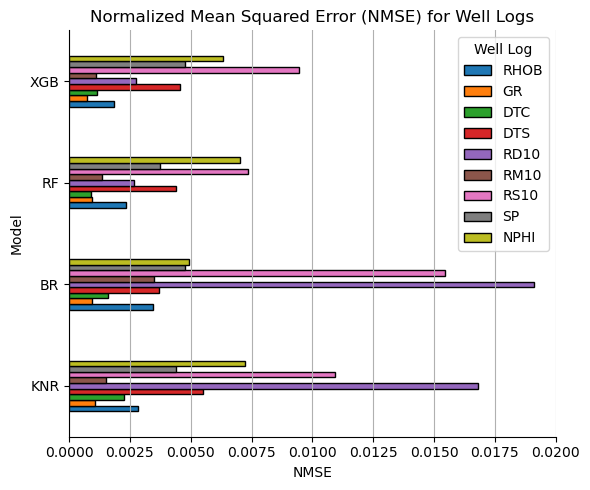

Model,KNR,BR,RF,XGB
RHOB,0.0028,0.0035,0.0023,0.0019
GR,0.0011,0.0010,0.0009,0.0007
DTC,0.0023,0.0016,0.0009,0.0011
DTS,0.0055,0.0037,0.0044,0.0046
RD10,0.0168,0.0191,0.0027,0.0028
RM10,0.0015,0.0035,0.0013,0.0011
RS10,0.0109,0.0154,0.0074,0.0094
SP,0.0044,0.0047,0.0037,0.0048
NPHI,0.0072,0.0049,0.0070,0.0063


In [20]:

ax = mse_results_df.plot(kind='barh', figsize=(6, 5), edgecolor='black')

plt.title('Normalized Mean Squared Error (NMSE) for Well Logs')
plt.ylabel('Model')
plt.xlabel('NMSE')

plt.xticks(rotation='horizontal')

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.xaxis.grid(True)
ax.legend(title='Well Log', bbox_to_anchor=(1, 1))

ax.set_xlim([0, 0.02])

plt.tight_layout() 
plt.show()

display(mse_results_df.T.round(4))



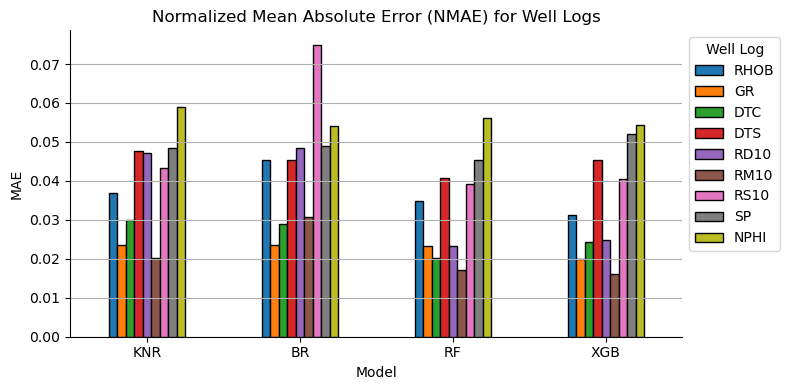

Model,KNR,BR,RF,XGB
RHOB,0.0369,0.0454,0.0349,0.0312
GR,0.0234,0.0236,0.0232,0.0200
DTC,0.0299,0.0290,0.0203,0.0243
DTS,0.0478,0.0453,0.0406,0.0454
RD10,0.0473,0.0484,0.0232,0.0249
RM10,0.0203,0.0308,0.0172,0.0160
RS10,0.0433,0.0749,0.0393,0.0405
SP,0.0483,0.0489,0.0454,0.0520
NPHI,0.0590,0.0540,0.0561,0.0544


In [21]:
ax = mae_results_df.plot(kind='bar', figsize=(8, 4), edgecolor='black')

plt.title('Normalized Mean Absolute Error (NMAE) for Well Logs')
plt.xlabel('Model')
plt.ylabel('MAE')

plt.xticks(rotation='horizontal')

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.grid(True)
ax.legend(title='Well Log', bbox_to_anchor=(1, 1))

plt.tight_layout() 
plt.show()

# ax.set_ylim([0, 0.1])

display(mae_results_df.T.round(4))




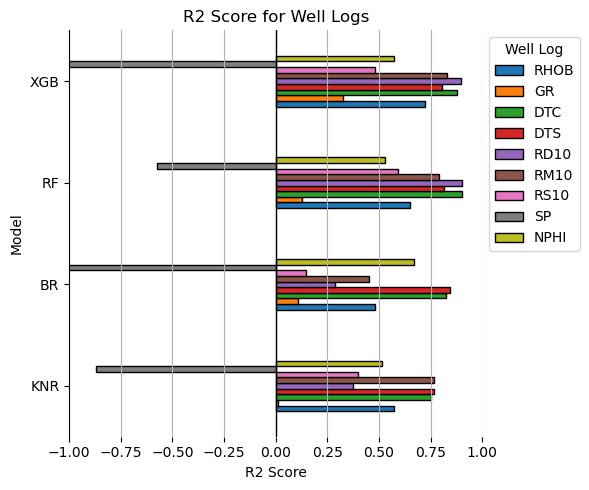

Model,KNR,BR,RF,XGB
RHOB,0.57,0.48,0.65,0.72
GR,0.01,0.11,0.13,0.32
DTC,0.75,0.82,0.90,0.87
DTS,0.77,0.84,0.81,0.81
RD10,0.37,0.29,0.90,0.90
RM10,0.76,0.45,0.79,0.83
RS10,0.40,0.15,0.59,0.48
SP,-0.87,-1.01,-0.58,-1.02
NPHI,0.51,0.67,0.53,0.57


In [22]:

ax = r2_results_df.plot(kind='barh', figsize=(6, 5), edgecolor='black')

plt.title('R2 Score for Well Logs')
plt.ylabel('Model')
plt.xlabel('R2 Score')
ax.legend(title='Well Log', bbox_to_anchor=(1, 1))
plt.xticks(rotation='horizontal')
plt.axvline(0, color='black', linewidth=1)

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)

ax.xaxis.grid(True)

ax.set_xlim([-1, 1])

plt.tight_layout()  
plt.show()
display(r2_results_df.T.round(2))


### 3.2. Performance by Well

In [17]:
# non-missing values for each columns
missing_wells = pd.DataFrame({'Non-Missing': test.count()/test.shape[0]})

# missing values for each well
for well, df in test.groupby('WELL'):
    missing_wells[well] = 1 - (df.count() / df.shape[0])
    
missing_wells = missing_wells.T


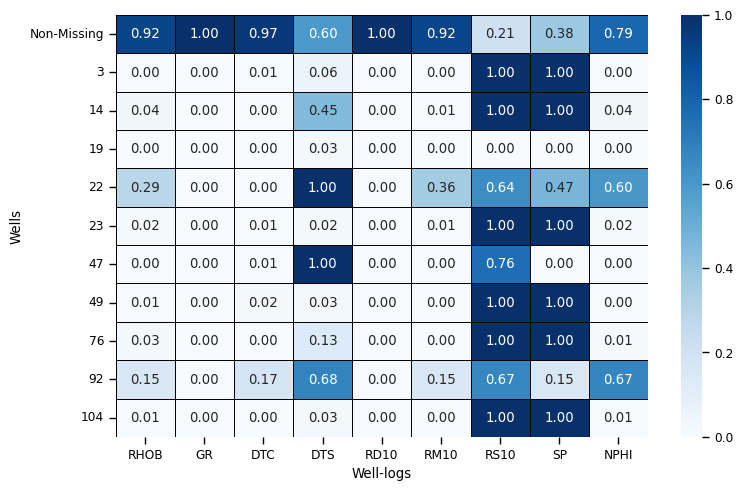

In [24]:
# fraction of missing values for each well
fig = plt.figure(figsize=(8, 5))
sns.set_context('paper')
cmap = sns.color_palette(palette='Blues', as_cmap=True)
axes = sns.heatmap(missing_wells[well_logs], linecolor='black', linewidths=0.5, vmin=0, vmax=1, cmap=cmap, annot=True, fmt='.2f')
axes.set_xlabel('Well-logs')
axes.set_ylabel('Wells')
axes.set_yticklabels(axes.get_yticklabels(), rotation=0)
plt.tight_layout()


In [25]:
unique_wells = test_df['WELL'].unique()

well_logs = ['RHOB', 'GR', 'DTC', 'DTS', 
             'RD10', 'RM10', 'RS10', 
             'SP', 'NPHI']

models = ['KNR', 'BR', 'RF', 'XGB']

# NMSE and R2
for well in unique_wells:
    well_data = test_df.loc[test_df['WELL'] == well]
    
    print('Blind-Well:', well)
    
    evaluation_results = {}
    for log in well_logs:

        evaluation_results[log] = {}
        for model in models:

            column_name = f'{log}_{model}'
            
            original_values = well_data[f'{log}_SCALED_{model}'].dropna()
            original_index = list(original_values.index.values)
            imputed_values = well_data.loc[original_index, f'{log}_IMP_SCALED_{model}']

            
            if original_values.notnull().any():
            
                mae = mean_absolute_error(original_values, imputed_values)
                mse = mean_squared_error(original_values, imputed_values)
                r2 = r2_score(original_values, imputed_values)
            else:
                mae, mse, r2 = None, None, None

            evaluation_results[log][model] = {'R2': r2, 'NMAE': mae, 'NMSE': mse}

    evaluation_results_df = {}
    for log, models in evaluation_results.items():

        table_data = []
        for model, metrics in models.items():
            cols = {'Model': model, 'R2': metrics['R2'], 'NMAE': metrics['NMAE'], 'NMSE': metrics['NMSE']}
            table_data.append(cols)

        df = pd.DataFrame(table_data)

        evaluation_results_df[log] = df


    r2_results_df = pd.DataFrame()
    mae_results_df = pd.DataFrame()
    mse_results_df = pd.DataFrame()

    for log, df in evaluation_results_df.items():
        r2_results_df[log] = df['R2']
        mae_results_df[log] = df['NMAE']
        mse_results_df[log] = df['NMSE']

    r2_results_df.index = df['Model']
    mae_results_df.index = df['Model']
    mse_results_df.index = df['Model']
    
    # results
    print('NMSE')
    display(mse_results_df.T.mean())
    print('R2')
    display(r2_results_df.T.mean())
    
    print('\n')

Blind-Well: 3
NMSE


Model
KNR    0.004447
BR     0.003092
RF     0.003055
XGB    0.003067
dtype: float64

R2


Model
KNR    0.346925
BR     0.510651
RF     0.556453
XGB    0.543743
dtype: float64



Blind-Well: 14
NMSE


Model
KNR    0.001583
BR     0.002269
RF     0.001369
XGB    0.001292
dtype: float64

R2


Model
KNR    0.722638
BR     0.673240
RF     0.763735
XGB    0.790082
dtype: float64



Blind-Well: 19
NMSE


Model
KNR    0.005729
BR     0.008814
RF     0.006247
XGB    0.005983
dtype: float64

R2


Model
KNR   -10.753692
BR    -15.828785
RF     -9.032254
XGB    -9.904688
dtype: float64



Blind-Well: 22
NMSE


Model
KNR    0.023135
BR     0.023323
RF     0.006515
XGB    0.007677
dtype: float64

R2


Model
KNR   -5.907359
BR    -2.692037
RF    -1.533876
XGB   -9.168800
dtype: float64



Blind-Well: 23
NMSE


Model
KNR    0.003728
BR     0.002015
RF     0.002417
XGB    0.002592
dtype: float64

R2


Model
KNR    0.482650
BR     0.552029
RF     0.625905
XGB    0.578632
dtype: float64



Blind-Well: 47
NMSE


Model
KNR    0.001428
BR     0.001598
RF     0.001455
XGB    0.001158
dtype: float64

R2


Model
KNR   -0.097499
BR     0.437659
RF     0.048410
XGB   -0.464656
dtype: float64



Blind-Well: 49
NMSE


Model
KNR    0.002696
BR     0.004044
RF     0.002387
XGB    0.002511
dtype: float64

R2


Model
KNR    0.139391
BR    -0.785972
RF     0.223308
XGB    0.147724
dtype: float64



Blind-Well: 76
NMSE


Model
KNR    0.000882
BR     0.000970
RF     0.000829
XGB    0.000947
dtype: float64

R2


Model
KNR    0.369878
BR     0.295908
RF     0.359023
XGB    0.343439
dtype: float64



Blind-Well: 92
NMSE


Model
KNR    0.003570
BR     0.002345
RF     0.003508
XGB    0.002544
dtype: float64

R2


Model
KNR    0.290643
BR     0.490217
RF     0.335759
XGB    0.424503
dtype: float64



Blind-Well: 104
NMSE


Model
KNR    0.000980
BR     0.001153
RF     0.000913
XGB    0.001306
dtype: float64

R2


Model
KNR    0.710885
BR     0.722432
RF     0.792278
XGB    0.738675
dtype: float64

In [26]:
test['WELL'] = test['WELL'].astype(str)

well_counts = test.groupby('WELL').count()
well_counts['Total'] = test.groupby('WELL').size()

well_counts_sorted = well_counts.sort_values(by='Total')
well_counts_sorted['Total']


WELL
49      7840
47      9033
19     10222
104    10677
23     10788
3      11063
14     11683
76     12216
22     17271
92     21604
Name: Total, dtype: int64

In [27]:
test['WELL'].unique().tolist()

['3', '14', '19', '22', '23', '47', '49', '76', '92', '104']

In [28]:
wells = ['3', '14', '19', '22', '23', '47', '49', '76', '92', '104']

avg_nmse = [0.0034, 0.0016, 0.0067, 0.0152, 0.0027,
            0.0014, 0.0029, 0.0009, 0.0030, 0.0011]

avg_r2 = [0.4894, 0.7374, -11.3799, -4.8255, 0.5598, 
          -0.0190, -0.0689, 0.3421, 0.3853, 0.7411]

data_wells = {'WELLS': wells,
              'AVG_NMSE': avg_nmse,
              'AVG_R2': avg_r2
             }

df_wells = pd.DataFrame(data_wells)

df_wells = df_wells.merge(well_counts_sorted[['Total']], how='left', left_on='WELLS', right_index=True)
df_wells.rename(columns={'Total': 'TOTAL'}, inplace=True)
df_wells.sort_values(by='TOTAL', ascending=False, inplace=True)

df_wells


,WELLS,AVG_NMSE,AVG_R2,TOTAL
8,92,0.0030,0.3853,21604
3,22,0.0152,-4.8255,17271
7,76,0.0009,0.3421,12216
1,14,0.0016,0.7374,11683
0,3,0.0034,0.4894,11063
4,23,0.0027,0.5598,10788
9,104,0.0011,0.7411,10677
2,19,0.0067,-11.3799,10222
5,47,0.0014,-0.0190,9033
6,49,0.0029,-0.0689,7840


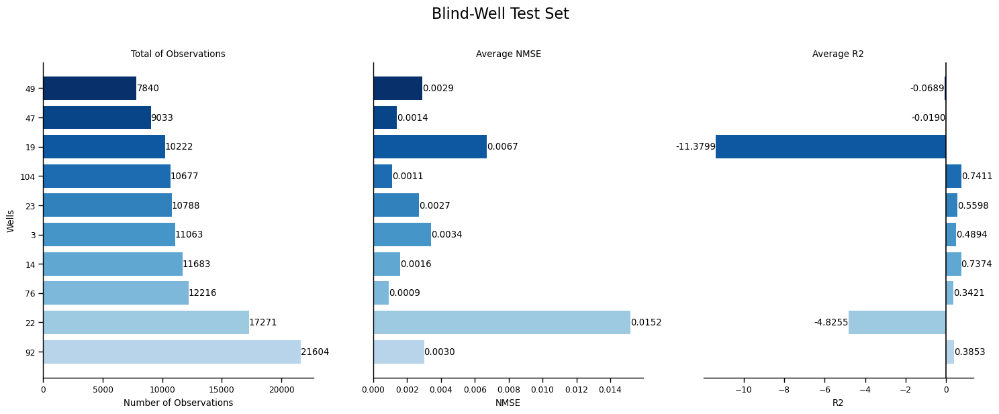

In [29]:
num_wells = len(df_wells)
colors = plt.cm.Blues(np.linspace(0.3, 1, num_wells))

fig, axes = plt.subplots(1, 3, figsize=(15, 6))

plt.suptitle('Blind-Well Test Set', fontsize=16, y=1.02)

axes[0].barh(df_wells['WELLS'], df_wells['TOTAL'], color=colors)
axes[0].set_xlabel('Number of Observations')
axes[0].set_ylabel('Wells')
axes[0].set_title('Total of Observations')
axes[0].spines['top'].set_visible(False)
axes[0].spines['right'].set_visible(False)
for value in axes[0].containers:
    axes[0].bar_label(value, label_type='edge')
plt.grid(False)


axes[1].barh(df_wells['WELLS'], df_wells['AVG_NMSE'], color=colors)
axes[1].set_xlabel('NMSE')
axes[1].set_title('Average NMSE')
axes[1].spines['right'].set_visible(False)
axes[1].spines['top'].set_visible(False)
axes[1].yaxis.set_visible(False)
for value in axes[1].containers:
    axes[1].bar_label(value, fmt='%.4f', label_type='edge')
plt.grid(False)

axes[2].barh(df_wells['WELLS'], df_wells['AVG_R2'], color=colors)
axes[2].set_xlabel('R2')
axes[2].set_title('Average R2')
axes[2].spines['right'].set_visible(False)
axes[2].spines['top'].set_visible(False)
axes[2].spines['left'].set_visible(False)
axes[2].yaxis.set_visible(False)
axes[2].axvline(x=0, color='black')

# axes[2].set_xlim(-1, 1)
for value in axes[2].containers:
    axes[2].bar_label(value, fmt='%.4f', label_type='edge')
plt.grid(False)

plt.tight_layout()
plt.show()


### 3.3. Performance by Stratigraphy

#### Train

In [18]:
# non-missing values for each columns
missing_strat = pd.DataFrame({'Non-Missing': train.count()/train.shape[0]})

# missing values for each stratigraphy
for well, df in train.groupby('STRAT'):
    missing_strat[well] = 1 - (df.count() / df.shape[0])
    
missing_strat = missing_strat.T


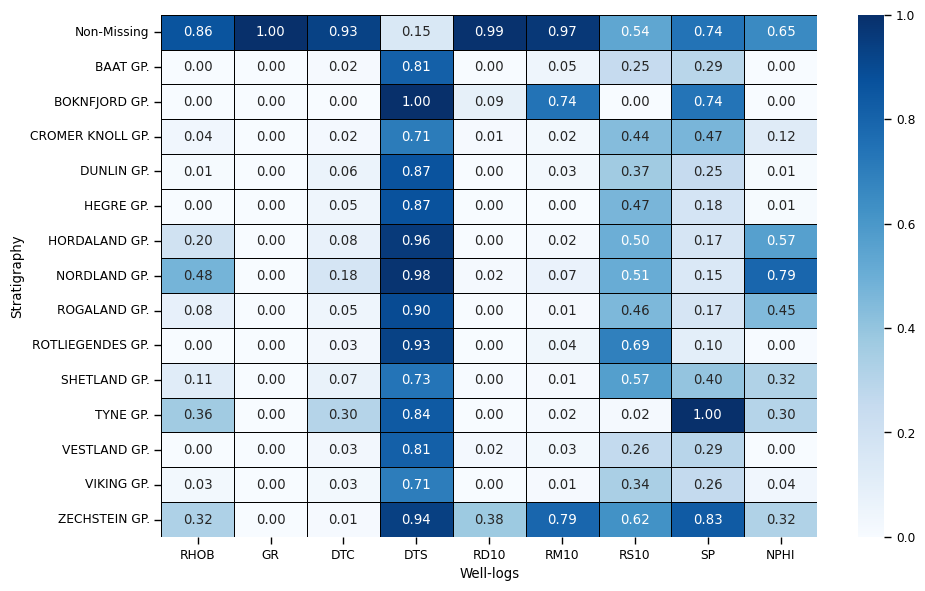

In [31]:
# fraction of missing values for each stratigraphy
fig = plt.figure(figsize=(10, 6))
sns.set_context('paper')
cmap = sns.color_palette(palette='Blues', as_cmap=True)
axes = sns.heatmap(missing_strat[well_logs], linecolor='black', linewidths=0.5, vmin=0, vmax=1, cmap=cmap, annot=True, fmt='.2f')
axes.set_xlabel('Well-logs')
axes.set_ylabel('Stratigraphy')
plt.tight_layout()


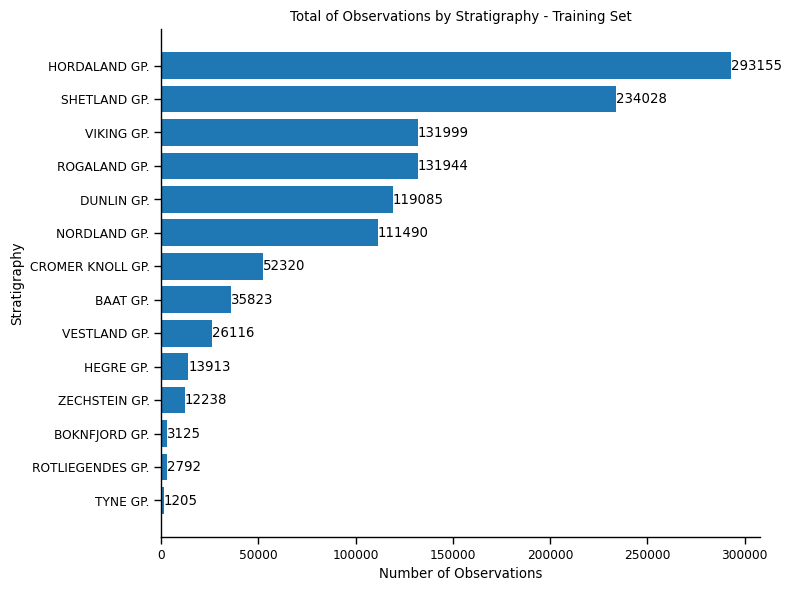

In [32]:
# count the number of observations for each stratigraphy
strat_counts = train.groupby('STRAT').count()
strat_counts['Total'] = train.groupby('STRAT').size()

# sort stratigraphy by total number of observations
strat_counts_sorted = strat_counts.sort_values(by='Total')

# plot the results
fig, axes = plt.subplots(figsize=(8,6))
axes.barh(strat_counts_sorted.index, strat_counts_sorted['Total'].values)
axes.set_xlabel('Number of Observations')
axes.set_ylabel('Stratigraphy')
axes.set_title('Total of Observations by Stratigraphy - Training Set')
axes.spines['top'].set_visible(False)
axes.spines['right'].set_visible(False)

# add count values to each bar
for value in axes.containers:
    axes.bar_label(value, label_type='edge')
plt.grid(False)
plt.tight_layout()
plt.show()


#### Test

In [33]:
# non-missing values for each columns
missing_strat = pd.DataFrame({'Non-Missing': test.count()/test.shape[0]})

# missing values for each stratigraphy
for well, df in test.groupby('STRAT'):
    missing_strat[well] = 1 - (df.count() / df.shape[0])
    
missing_strat = missing_strat.T


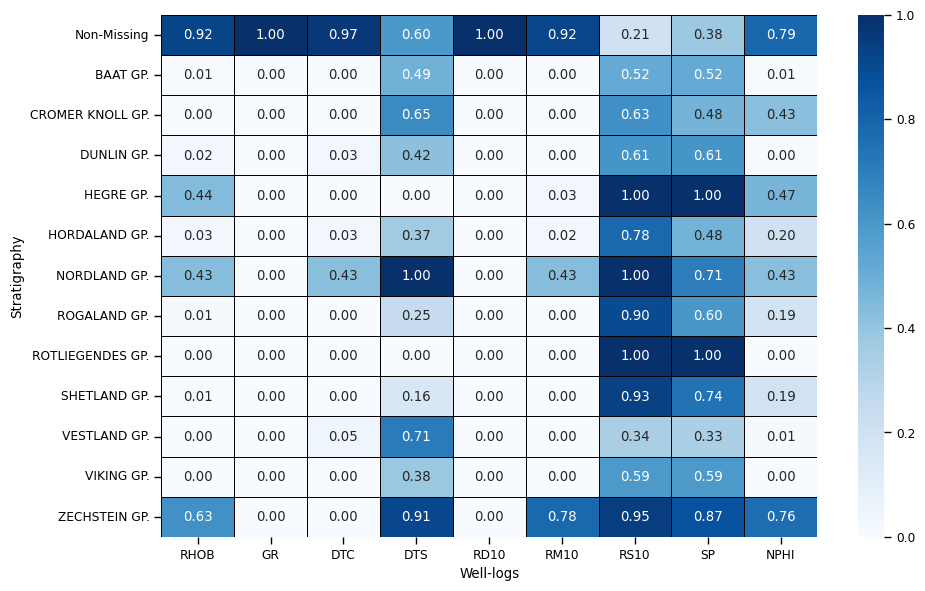

In [34]:
# fraction of missing values for each stratigraphy
fig = plt.figure(figsize=(10, 6))
sns.set_context('paper')
cmap = sns.color_palette(palette='Blues', as_cmap=True)
axes = sns.heatmap(missing_strat[well_logs], linecolor='black', linewidths=0.5, vmin=0, vmax=1, cmap=cmap, annot=True, fmt='.2f')
axes.set_xlabel('Well-logs')
axes.set_ylabel('Stratigraphy')
plt.tight_layout()


In [35]:
unique_strat = test['STRAT'].unique()

well_logs = ['RHOB', 'GR', 'DTC', 'DTS', 
             'RD10', 'RM10', 'RS10', 
             'SP', 'NPHI']

models = ['KNR', 'BR', 'RF', 'XGB']

# NMSE and R2
for strat in unique_strat:
    strat_data = test_df.loc[test_df['STRAT'] == strat]
    
    print('Stratigraphy:', strat)
    
    evaluation_results = {}
    for log in well_logs:

        evaluation_results[log] = {}
        for model in models:

            column_name = f'{log}_{model}'

            original_values = strat_data[f'{log}_SCALED_{model}'].dropna()
            original_index = list(original_values.index.values)
            imputed_values = strat_data.loc[original_index, f'{log}_IMP_SCALED_{model}']

            
            if original_values.notnull().any():
            
                mae = mean_absolute_error(original_values, imputed_values)
                mse = mean_squared_error(original_values, imputed_values)
                r2 = r2_score(original_values, imputed_values)
            else:
                mae, mse, r2 = None, None, None

            evaluation_results[log][model] = {'R2': r2, 'NMAE': mae, 'NMSE': mse}

    evaluation_results_df = {}
    for log, models in evaluation_results.items():

        table_data = []
        for model, metrics in models.items():
            cols = {'Model': model, 'R2': metrics['R2'], 'NMAE': metrics['NMAE'], 'NMSE': metrics['NMSE']}
            table_data.append(cols)

        df = pd.DataFrame(table_data)

        evaluation_results_df[log] = df


    r2_results_df = pd.DataFrame()
    mae_results_df = pd.DataFrame()
    mse_results_df = pd.DataFrame()

    for log, df in evaluation_results_df.items():
        r2_results_df[log] = df['R2']
        mae_results_df[log] = df['NMAE']
        mse_results_df[log] = df['NMSE']

    r2_results_df.index = df['Model']
    mae_results_df.index = df['Model']
    mse_results_df.index = df['Model']
    
    # results
    print('NMSE')
    display(mse_results_df.T.mean())
    print('R2')
    display(r2_results_df.T.mean())
    
    print('\n')

Stratigraphy: HORDALAND GP.
NMSE


Model
KNR    0.004665
BR     0.005598
RF     0.004537
XGB    0.003985
dtype: float64

R2


Model
KNR    -0.727022
BR    -10.426934
RF     -0.548797
XGB    -0.470529
dtype: float64



Stratigraphy: ROGALAND GP.
NMSE


Model
KNR    0.002711
BR     0.003299
RF     0.002657
XGB    0.002709
dtype: float64

R2


Model
KNR   -0.035417
BR    -2.619271
RF     0.144726
XGB    0.167770
dtype: float64



Stratigraphy: SHETLAND GP.
NMSE


Model
KNR    0.001355
BR     0.002673
RF     0.001224
XGB    0.001309
dtype: float64

R2


Model
KNR    0.335627
BR    -0.210637
RF     0.360151
XGB    0.331128
dtype: float64



Stratigraphy: CROMER KNOLL GP.
NMSE


Model
KNR    0.004322
BR     0.004229
RF     0.004008
XGB    0.004193
dtype: float64

R2


Model
KNR    0.006988
BR     0.023248
RF     0.262381
XGB    0.036952
dtype: float64



Stratigraphy: VIKING GP.
NMSE


Model
KNR    0.002745
BR     0.002733
RF     0.002192
XGB    0.002101
dtype: float64

R2


Model
KNR    0.254062
BR     0.169914
RF     0.370801
XGB    0.371991
dtype: float64



Stratigraphy: VESTLAND GP.
NMSE


Model
KNR    0.006558
BR     0.003152
RF     0.003233
XGB    0.005872
dtype: float64

R2


Model
KNR   -10.024896
BR     -5.068622
RF     -2.469494
XGB   -25.612969
dtype: float64



Stratigraphy: NORDLAND GP.
NMSE


Model
KNR    0.001304
BR     0.002580
RF     0.001494
XGB    0.001619
dtype: float64

R2


Model
KNR    -5.256853
BR     -1.108468
RF     -2.605169
XGB   -30.208882
dtype: float64



Stratigraphy: HEGRE GP.
NMSE


Model
KNR    0.000628
BR     0.000646
RF     0.000642
XGB    0.000542
dtype: float64

R2


Model
KNR    0.117979
BR     0.125812
RF     0.162463
XGB    0.259621
dtype: float64



Stratigraphy: ZECHSTEIN GP.
NMSE


Model
KNR    0.074249
BR     0.073935
RF     0.025830
XGB    0.037857
dtype: float64

R2


Model
KNR    -55.854881
BR     -23.932987
RF     -23.126320
XGB   -145.999604
dtype: float64



Stratigraphy: ROTLIEGENDES GP.
NMSE


Model
KNR    0.001383
BR     0.003089
RF     0.000660
XGB    0.000409
dtype: float64

R2


Model
KNR    -6.773448
BR    -28.160507
RF     -2.820402
XGB    -1.963225
dtype: float64



Stratigraphy: BAAT GP.
NMSE


Model
KNR    0.003421
BR     0.005947
RF     0.003028
XGB    0.004139
dtype: float64

R2


Model
KNR   -5.218966
BR    -4.686568
RF    -2.583891
XGB   -4.435344
dtype: float64



Stratigraphy: DUNLIN GP.
NMSE


Model
KNR    0.002422
BR     0.002584
RF     0.001984
XGB    0.002093
dtype: float64

R2


Model
KNR   -7.141971
BR    -6.070740
RF    -3.153757
XGB   -6.435070
dtype: float64

In [36]:
# count the number of observations for each stratigraphy
strat_counts = test.groupby('STRAT').count()
strat_counts['Total'] = test.groupby('STRAT').size()

# sort stratigraphy by total number of observations
strat_counts_sorted = strat_counts.sort_values(by='Total')
strat_counts_sorted['Total']

STRAT
HEGRE GP.             969
ROTLIEGENDES GP.     1558
BAAT GP.             2598
VESTLAND GP.         3957
DUNLIN GP.           6088
NORDLAND GP.         6346
CROMER KNOLL GP.     7054
ZECHSTEIN GP.        8015
ROGALAND GP.        12943
VIKING GP.          17415
SHETLAND GP.        27599
HORDALAND GP.       27855
Name: Total, dtype: int64

In [37]:
test['STRAT'].unique().tolist()

['HORDALAND GP.',
 'ROGALAND GP.',
 'SHETLAND GP.',
 'CROMER KNOLL GP.',
 'VIKING GP.',
 'VESTLAND GP.',
 'NORDLAND GP.',
 'HEGRE GP.',
 'ZECHSTEIN GP.',
 'ROTLIEGENDES GP.',
 'BAAT GP.',
 'DUNLIN GP.']

In [38]:
strats = ['HORDALAND GP.', 'ROGALAND GP.', 'SHETLAND GP.',
          'CROMER KNOLL GP.', 'VIKING GP.', 'VESTLAND GP.',
          'NORDLAND GP.', 'HEGRE GP.', 'ZECHSTEIN GP.',
          'ROTLIEGENDES GP.', 'BAAT GP.', 'DUNLIN GP.']

avg_nmse = [0.0047, 0.0028, 0.0016, 0.0042, 0.0024, 0.0047, 
            0.0017, 0.0006, 0.0530, 0.0014, 0.0041, 0.0023]
avg_r2 = [-3.0433, -0.5855, 0.2041, 0.0824, 0.2917, -10.7940,
          -9.7948, 0.1665, -62.2284, -9.9294, -4.2312, -5.7004]

data_strats = {'STRATS': strats,
              'AVG_NMSE': avg_nmse,
              'AVG_R2': avg_r2
             }

df_strats = pd.DataFrame(data_strats)

df_strats = df_strats.merge(strat_counts_sorted[['Total']], how='left', left_on='STRATS', right_index=True)
df_strats.rename(columns={'Total': 'TOTAL'}, inplace=True)
df_strats.sort_values(by='TOTAL', ascending=False, inplace=True)

df_strats


,STRATS,AVG_NMSE,AVG_R2,TOTAL
0,HORDALAND GP.,0.0047,-3.0433,27855
2,SHETLAND GP.,0.0016,0.2041,27599
4,VIKING GP.,0.0024,0.2917,17415
1,ROGALAND GP.,0.0028,-0.5855,12943
8,ZECHSTEIN GP.,0.0530,-62.2284,8015
3,CROMER KNOLL GP.,0.0042,0.0824,7054
6,NORDLAND GP.,0.0017,-9.7948,6346
11,DUNLIN GP.,0.0023,-5.7004,6088
5,VESTLAND GP.,0.0047,-10.7940,3957
10,BAAT GP.,0.0041,-4.2312,2598


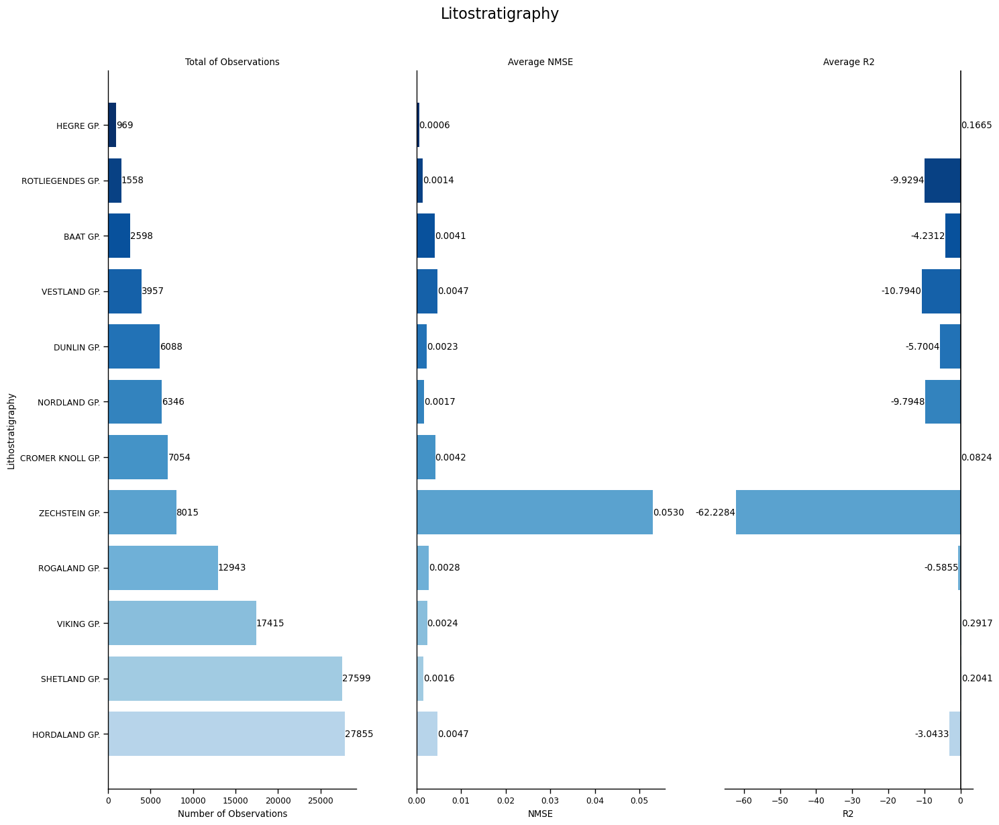

In [56]:
num_strat = len(df_strats)
colors = plt.cm.Blues(np.linspace(0.3, 1, num_strat))

fig, axes = plt.subplots(1, 3, figsize=(15, 12))

plt.suptitle('Litostratigraphy', fontsize=16, y=1.02)

axes[0].barh(df_strats['STRATS'], df_strats['TOTAL'], color=colors)
axes[0].set_xlabel('Number of Observations')
axes[0].set_ylabel('Lithostratigraphy')
axes[0].set_title('Total of Observations')
axes[0].spines['top'].set_visible(False)
axes[0].spines['right'].set_visible(False)
for value in axes[0].containers:
    axes[0].bar_label(value, label_type='edge')
plt.grid(False)

axes[1].barh(df_strats['STRATS'], df_strats['AVG_NMSE'], color=colors)
axes[1].set_xlabel('NMSE')
axes[1].set_ylabel('Lithostratigraphy')
axes[1].set_title('Average NMSE')
axes[1].spines['right'].set_visible(False)
axes[1].spines['top'].set_visible(False)
axes[1].yaxis.set_visible(False)

# axes[1].yaxis.set_visible(False)
for value in axes[1].containers:
    axes[1].bar_label(value, fmt='%.4f', label_type='edge')
plt.grid(False)

axes[2].barh(df_strats['STRATS'], df_strats['AVG_R2'], color=colors)
axes[2].set_xlabel('R2')
axes[2].set_title('Average R2')
axes[2].spines['right'].set_visible(False)
axes[2].spines['top'].set_visible(False)
axes[2].spines['left'].set_visible(False)
axes[2].yaxis.set_visible(False)
axes[2].axvline(x=0, color='black')

# axes[2].set_xlim(-10, 1)

for value in axes[2].containers:
    axes[2].bar_label(value, fmt='%.4f', label_type='edge')
plt.grid(False)

plt.tight_layout()
plt.show()

### 3.4. Plotting Well-logs

In [32]:
def results_wells(df, features, name_well, model): 
    
    well = df[df['WELL'] == name_well] 

    fig, ax = plt.subplots(nrows=1, ncols=len(features), figsize=(15,10))

    for idx, feature in enumerate(features):
        if well[feature].notnull().any():
            ax[idx].plot(well[f'{feature}'], well['DEPTH'], marker='.', markersize=1, linewidth=0.8, alpha=0.5, color='blue', label='Original')
            ax[idx].plot(well[f'{feature}_IMP_{model}'], well['DEPTH'], linewidth=0.6, color='red', alpha=0.8, label='Predicted')
    #                 ax[idx].plot(well[f'{feature}_MICE'], well['DEPTH'], marker='o', linewidth=0.6, markersize=0.5, color='red', alpha=0.8, label='Predicted')
            ax[idx].set_ylim([min(well['DEPTH']), max(well['DEPTH'])])
            ax[idx].invert_yaxis()
            ax[idx].set_xlabel(feature)

            if idx == 0:
                ax[idx].set_ylabel('DEPTH')

            if feature == 'R10':
                ax[idx].set_xscale('log')

            ax[idx].grid(True) 
    ax[idx].legend()
    fig.suptitle(f'Well {name_well} - Model {model}', fontsize=16)
    plt.tight_layout()
    plt.show()
    
def results_wells_scatter(df, features, name_well, model): 
    
    well = df[df['WELL'] == name_well] 

    fig, ax = plt.subplots(nrows=1, ncols=len(features), figsize=(20, 4))

    for idx, feature in enumerate(features):
        if well[feature].notnull().any():
            sns.scatterplot(data=well, x=f'{feature}', y=f'{feature}_IMP_{model}', hue='STRAT', ax=ax[idx])
#             ax[idx].set_ylim([min(well['DEPTH']), max(well['DEPTH'])])
#             ax[idx].invert_yaxis()
            ax[idx].set_xlabel(feature)

            ax[idx].grid(True)
        
    ax[idx].legend()
    fig.suptitle(f'Well {name_well} - Model {model}', fontsize=16)
    plt.tight_layout()
    plt.show()
    

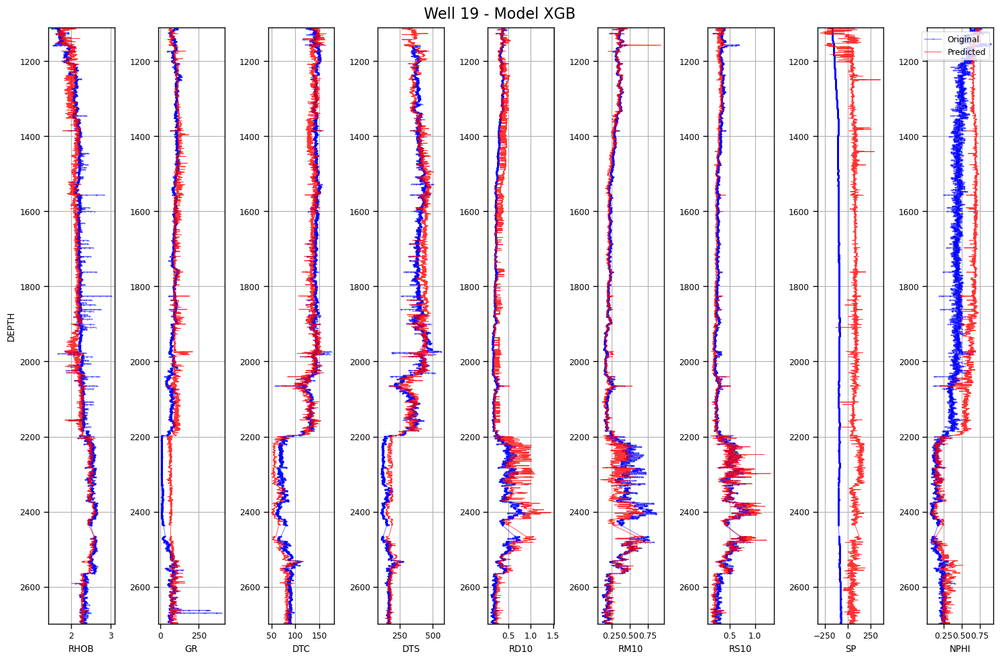

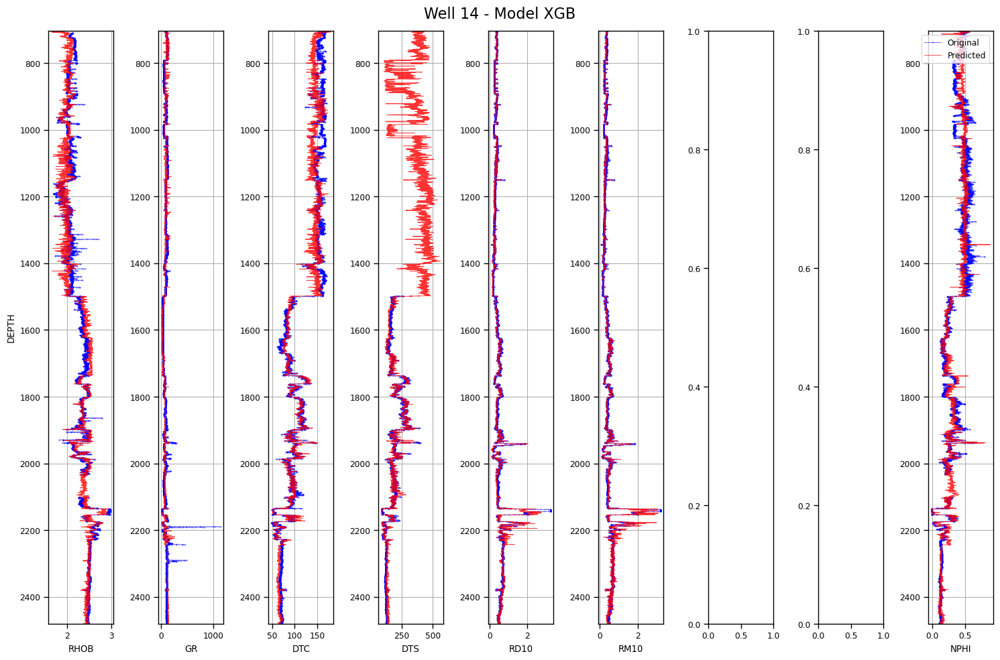

In [92]:
well_logs = ['RHOB', 'GR', 'DTC', 'DTS', 
             'RD10', 'RM10', 'RS10', 
             'SP', 'NPHI']

models = ['XGB']

# test_wells_plot = test_df['WELL'].unique()
test_wells_plot = [19, 14]

for well in test_wells_plot:
    for model in models:
    
        results_wells(df=test_df, features=well_logs, name_well=well, model=model) 

In [19]:
     
def results_wells_scatter(df, features, name_well, model): 
    
    well = df[df['WELL'] == name_well] 

    for idx, feature in enumerate(features):
        if well[feature].notnull().any():
            fig, ax = plt.subplots(figsize=(5, 5))
            scatter = sns.scatterplot(data=well, x=f'{feature}_IMP_{model}', y=f'{feature}', hue='STRAT', ax=ax)

            ax.set_xlabel(feature)
            scatter.legend_.remove()
            ax.set_xlabel(f'Imputed Values')
            ax.set_ylabel(f'Original Values')

            ax.grid(True)
            ax.axis('equal')
            ax.legend()
            plt.title(f'Well {name_well} - {feature}')
            plt.tight_layout()
            plt.show()
  

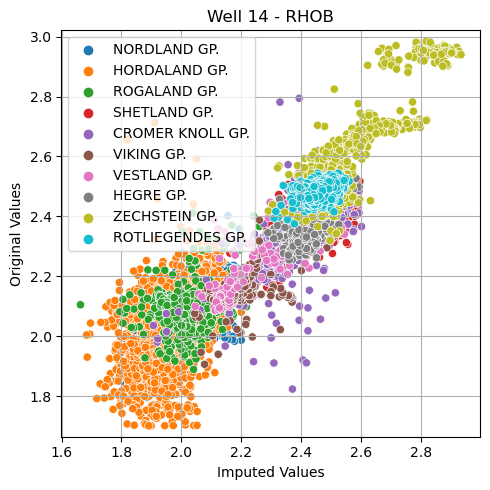

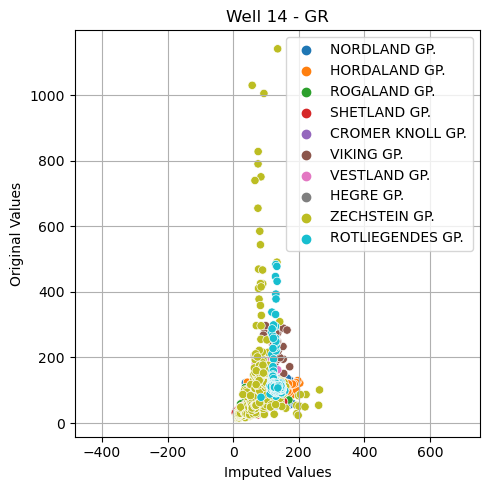

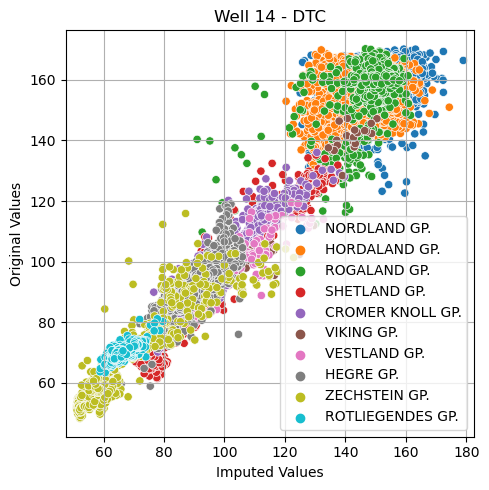

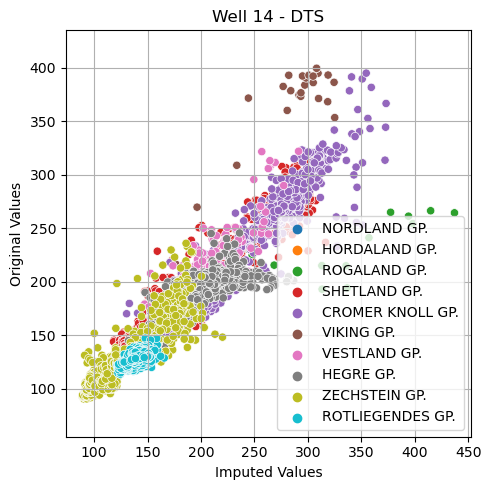

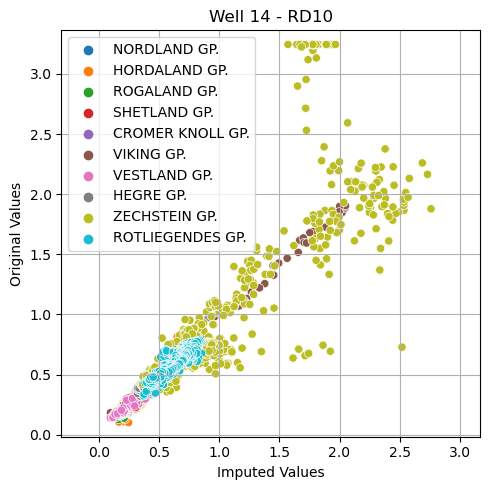

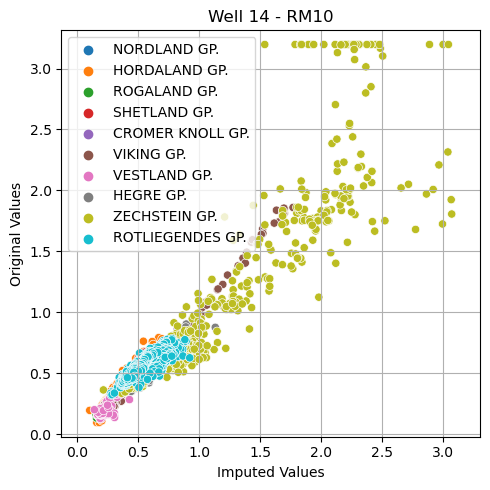

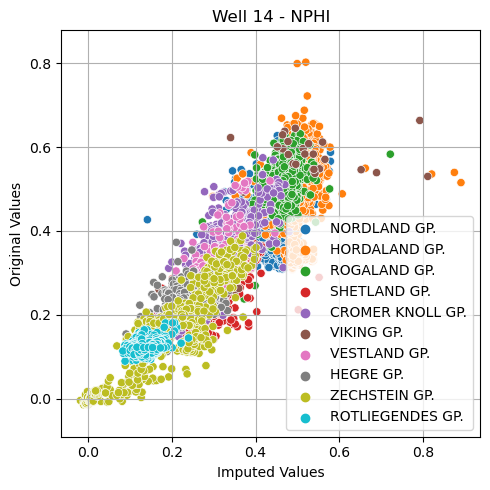

In [20]:
well_logs = ['RHOB', 'GR', 'DTC', 'DTS', 
             'RD10', 'RM10', 'RS10', 
             'SP', 'NPHI']

models = ['XGB']

# test_wells_plot = test_df['WELL'].unique()
test_wells_plot = [14]

for well in test_wells_plot:
    for model in models:
    
        results_wells_scatter(df=test_df, features=well_logs, name_well=well, model=model) 

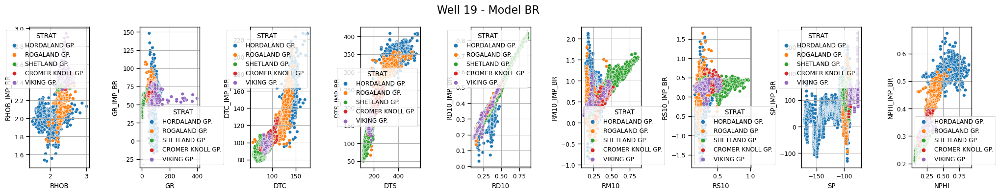

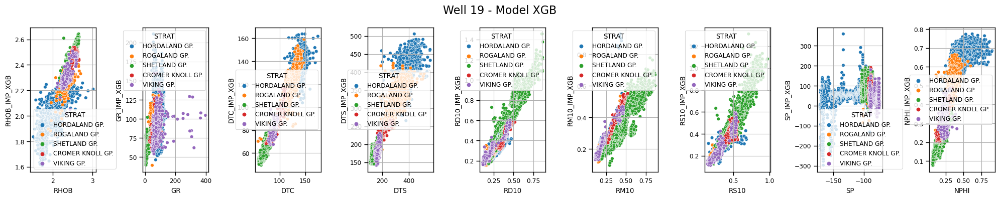

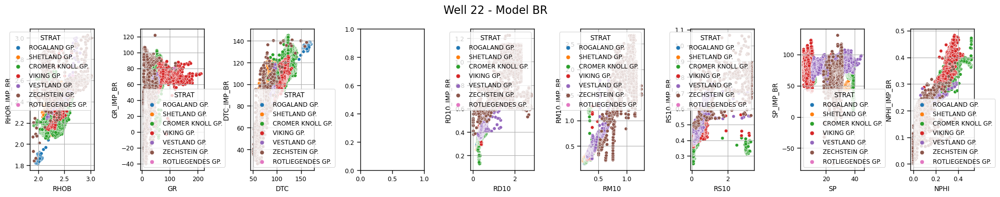

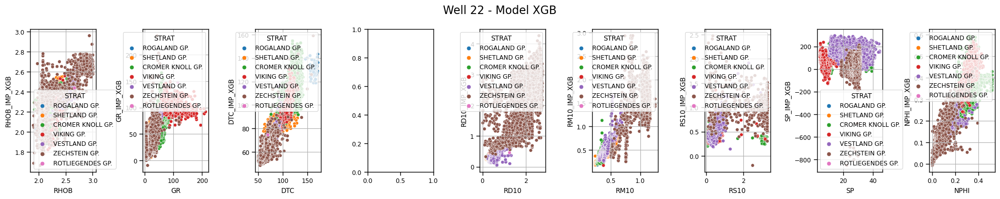

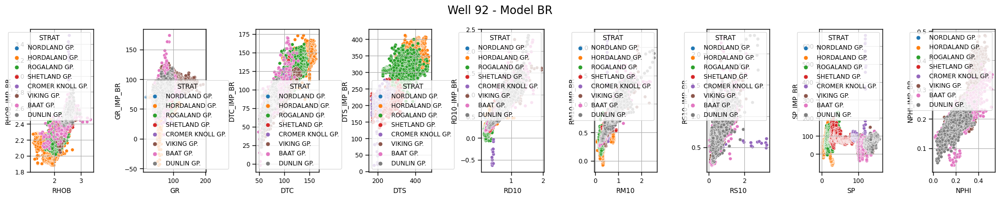

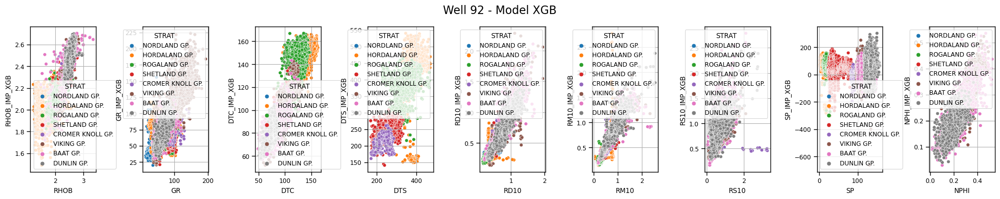

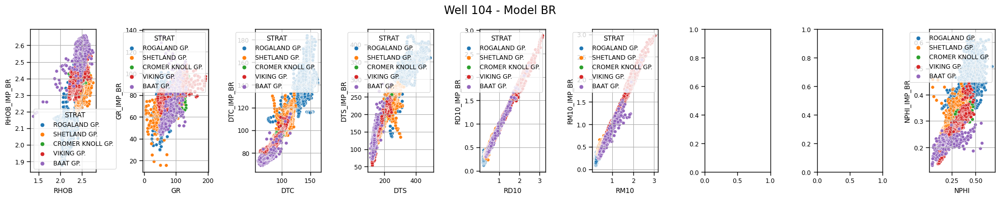

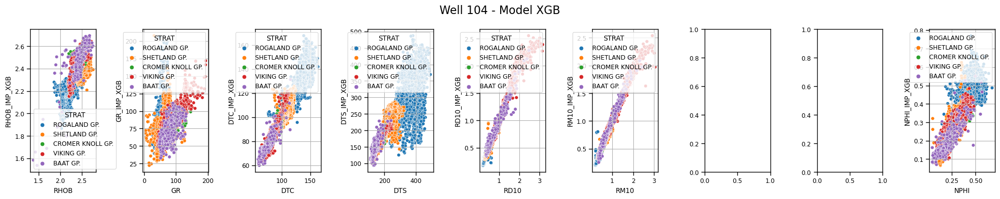

In [51]:
well_logs = ['RHOB', 'GR', 'DTC', 'DTS', 
             'RD10', 'RM10', 'RS10', 
             'SP', 'NPHI']

models = ['BR', 'XGB']

# test_wells_plot = test_df['WELL'].unique()
test_wells_plot = [19, 22, 92, 104]

for well in test_wells_plot:
    for model in models:
    
        results_wells_scatter(df=test_df, features=well_logs, name_well=well, model=model) 

### 3.5. Plotting Stratigraphy

In [66]:
def results_wells_strat(df, features, name_well, model, lito_strat):
    strat_df = df[df['STRAT'] == lito_strat] 
    
    
    well = strat_df[strat_df['WELL'] == name_well] 


    fig, ax = plt.subplots(nrows=1, ncols=len(features), figsize=(15,10))

    for idx, feature in enumerate(features):
        if well[feature].notnull().any():
            ax[idx].plot(well[f'{feature}'], well['DEPTH'], marker='.', markersize=1, linewidth=0.8, alpha=0.5, color='blue', label='Original')
            ax[idx].plot(well[f'{feature}_IMP_{model}'], well['DEPTH'], linewidth=0.6, color='red', alpha=0.8, label='Predicted')
    #                 ax[idx].plot(well[f'{feature}_MICE'], well['DEPTH'], marker='o', linewidth=0.6, markersize=0.5, color='red', alpha=0.8, label='Predicted')
            ax[idx].set_ylim([min(well['DEPTH']), max(well['DEPTH'])])
            ax[idx].invert_yaxis()
            ax[idx].set_xlabel(feature)

            if idx == 0:
                ax[idx].set_ylabel('DEPTH')

            if feature == 'R10':
                ax[idx].set_xscale('log')

            ax[idx].grid(True) 
    ax[idx].legend()
    fig.suptitle(f'Well {name_well} - Model {model} - Litostratigraphy {lito_strat}', fontsize=16)
    plt.tight_layout()
    plt.show()
    
    
def results_wells_strat_scatter(df, features, name_well, model, lito_strat):
    strat_df = df[df['STRAT'] == lito_strat] 
    
    
    well = strat_df[strat_df['WELL'] == name_well] 


    fig, ax = plt.subplots(nrows=1, ncols=len(features), figsize=(20, 4))

    for idx, feature in enumerate(features):
        if well[feature].notnull().any():
            sns.scatterplot(data=well, x=f'{feature}', y=f'{feature}_IMP_{model}', hue='STRAT', ax=ax[idx])

            ax[idx].grid(True) 
    ax[idx].legend()
    fig.suptitle(f'Well {name_well} - Model {model} - Litostratigraphy {lito_strat}', fontsize=16)
    plt.tight_layout()
    plt.show()

In [54]:
test['STRAT'].unique().tolist()

['HORDALAND GP.',
 'ROGALAND GP.',
 'SHETLAND GP.',
 'CROMER KNOLL GP.',
 'VIKING GP.',
 'VESTLAND GP.',
 'NORDLAND GP.',
 'HEGRE GP.',
 'ZECHSTEIN GP.',
 'ROTLIEGENDES GP.',
 'BAAT GP.',
 'DUNLIN GP.']

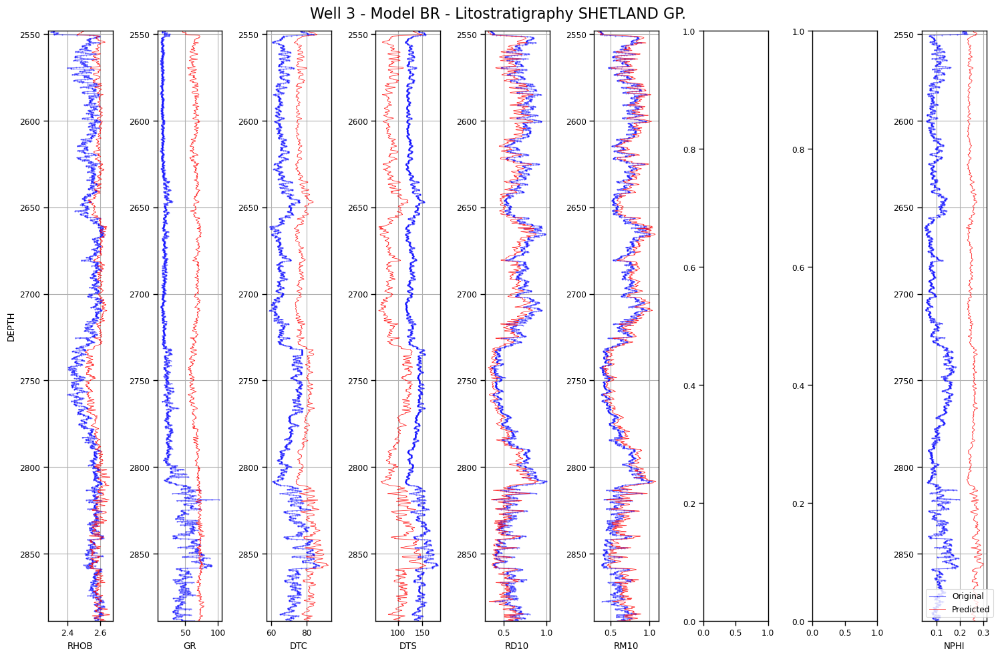

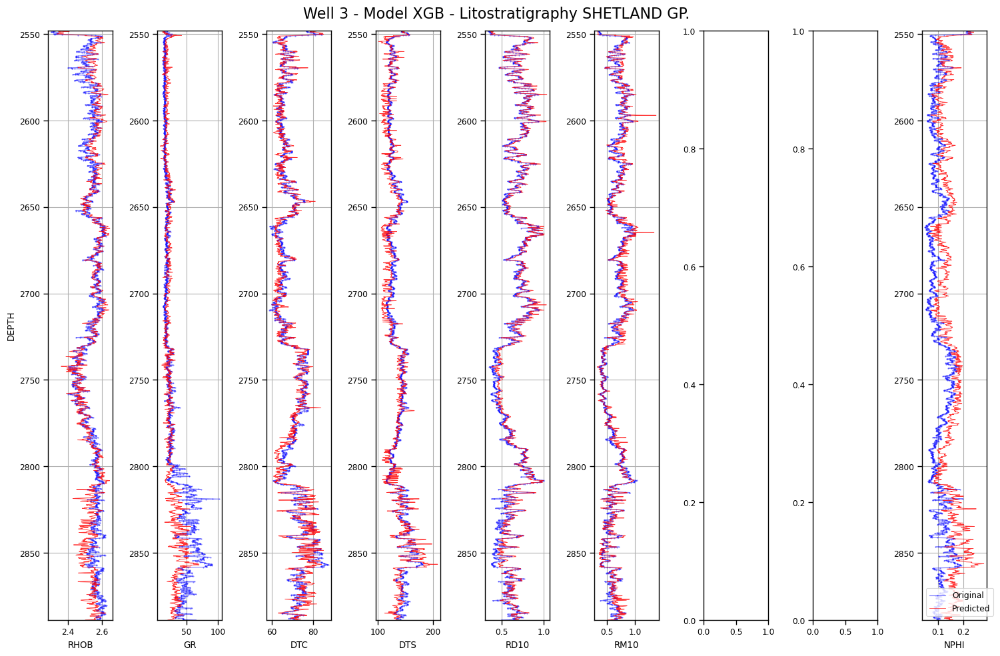

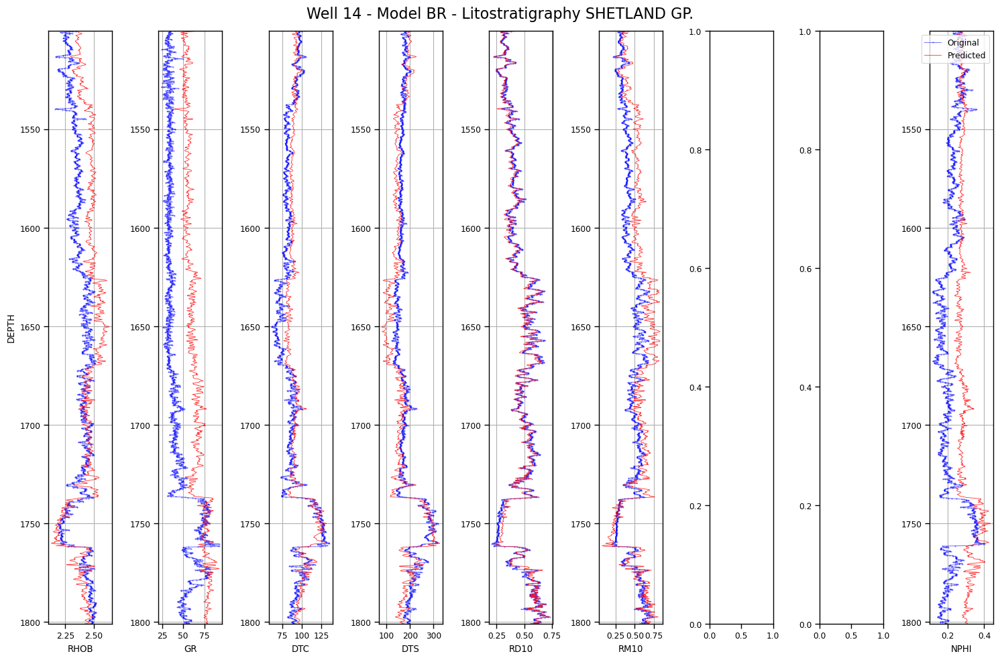

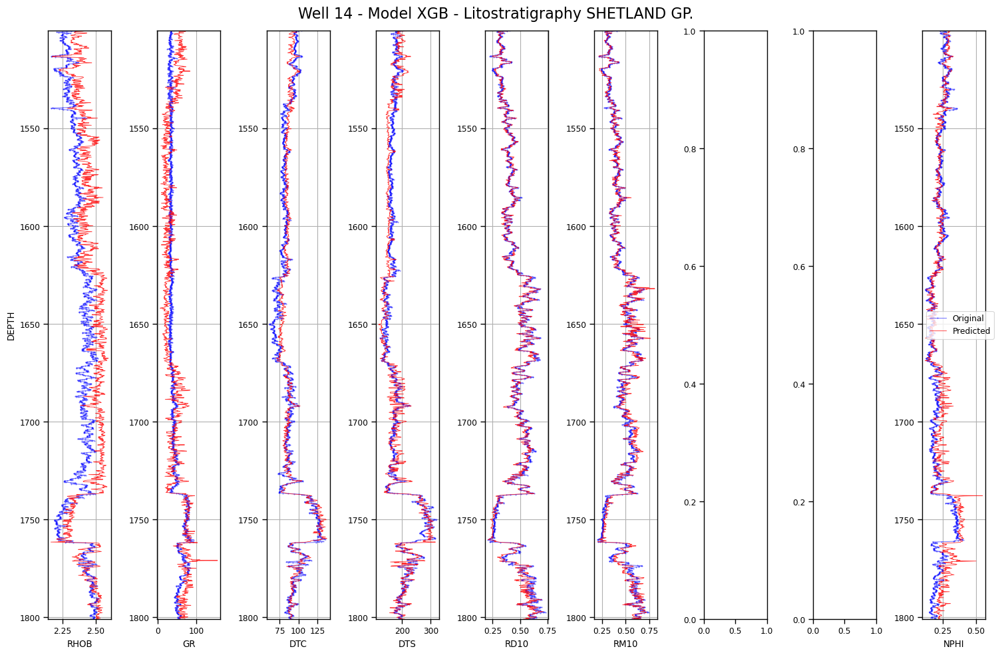

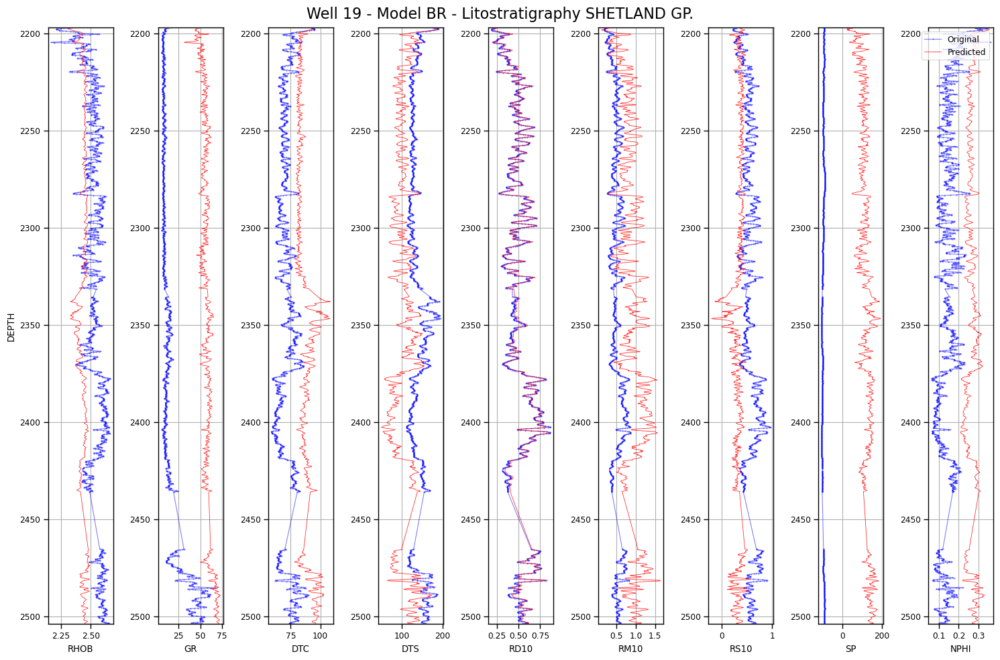

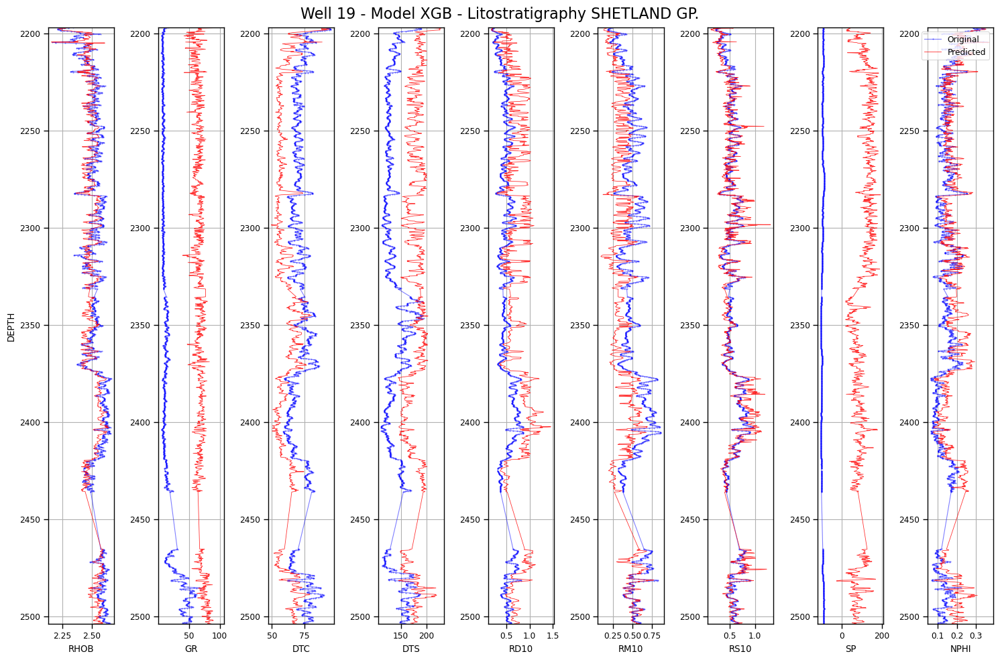

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


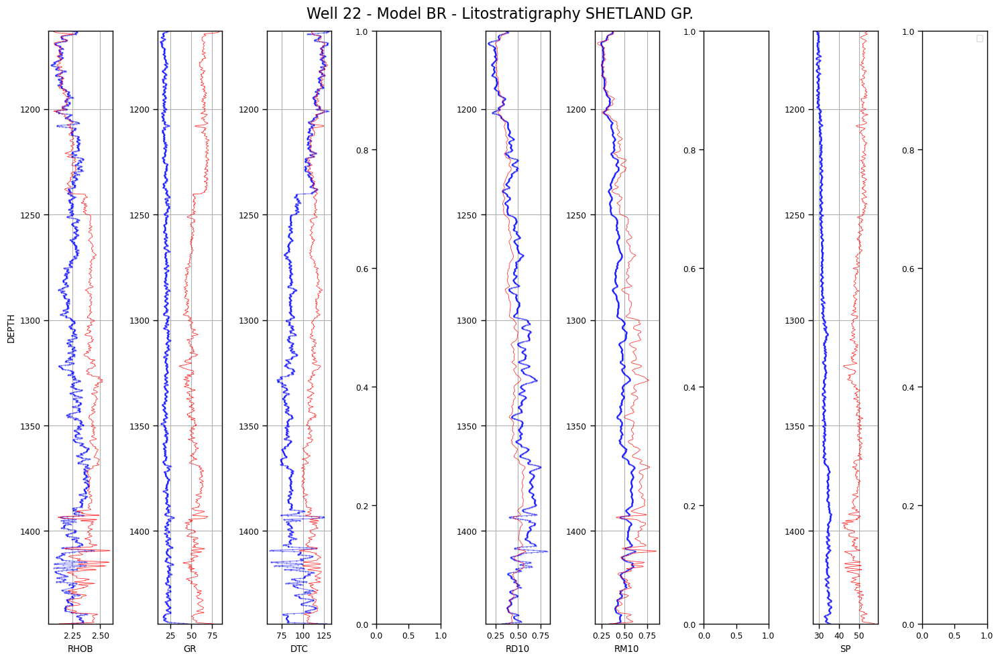

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


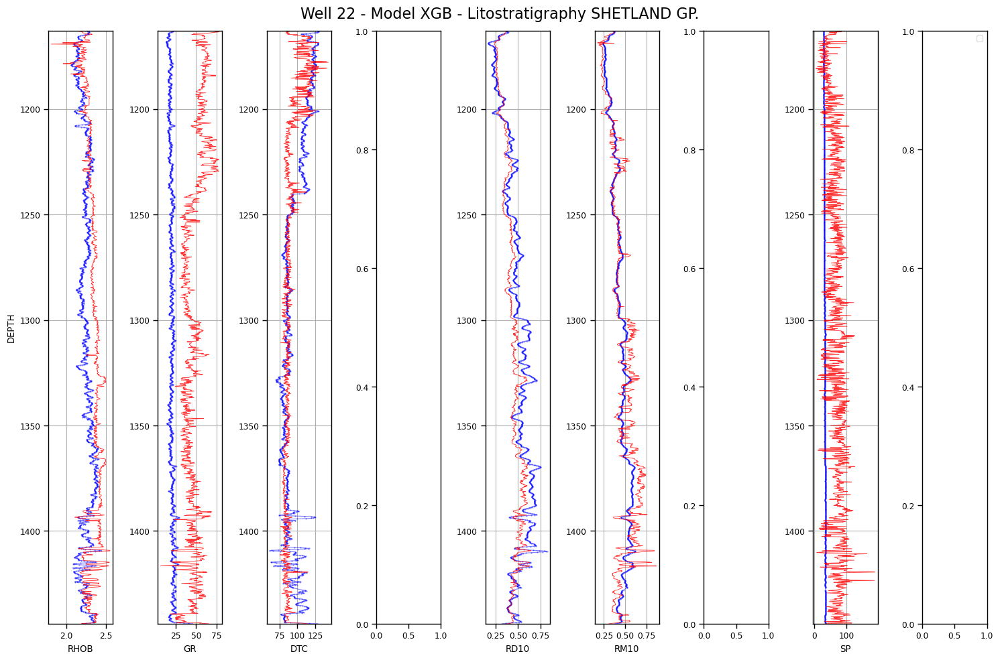

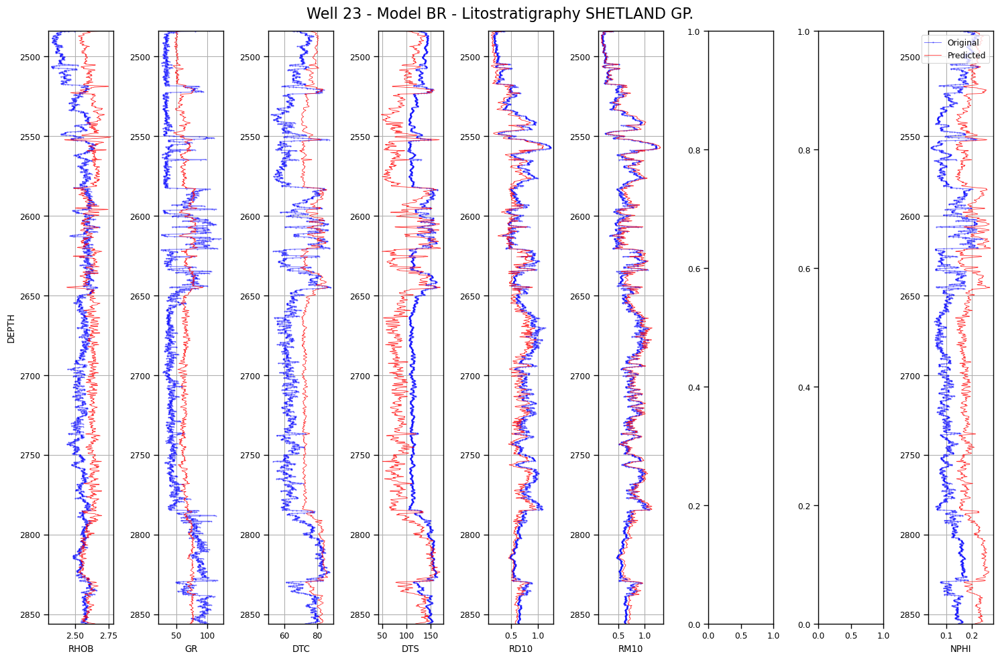

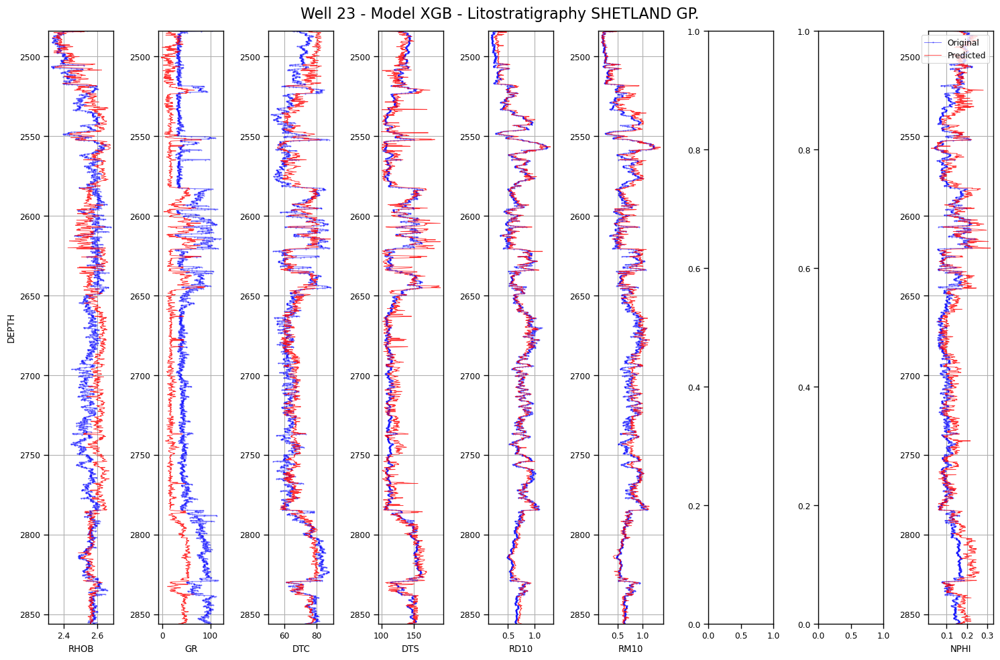

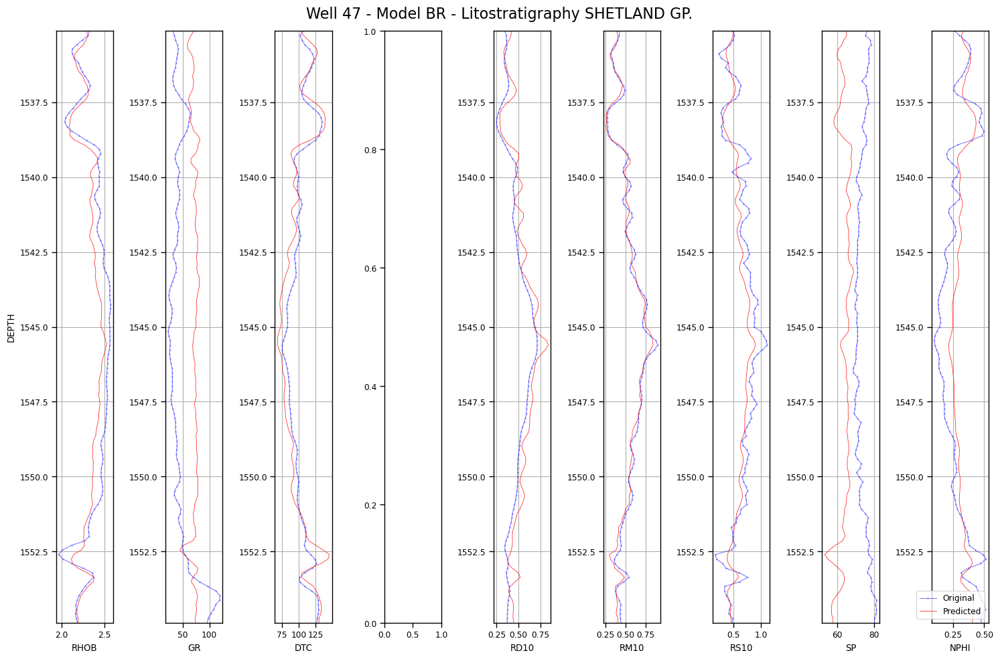

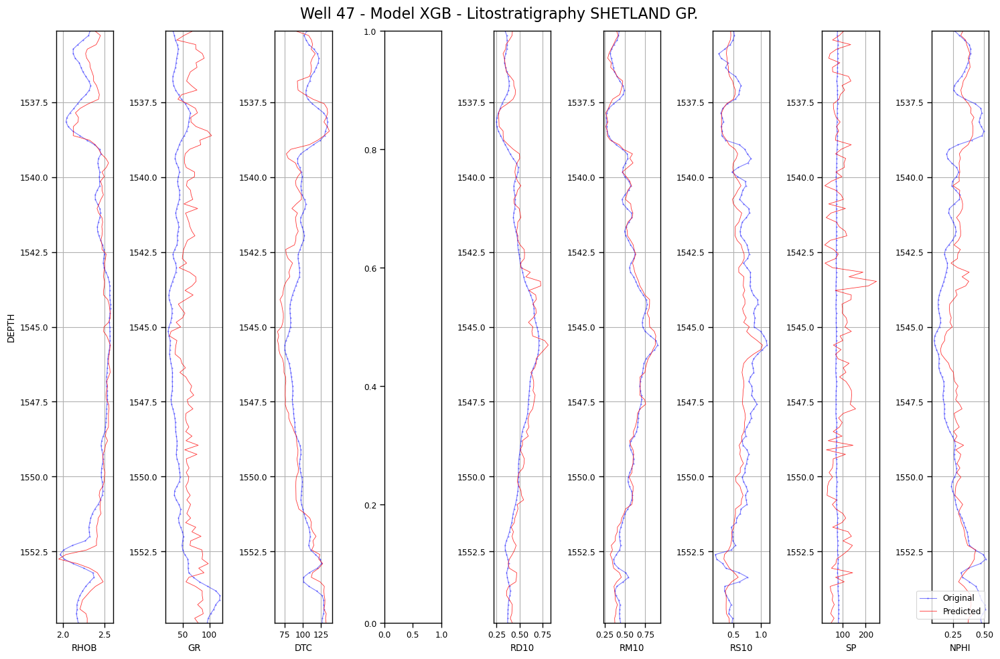

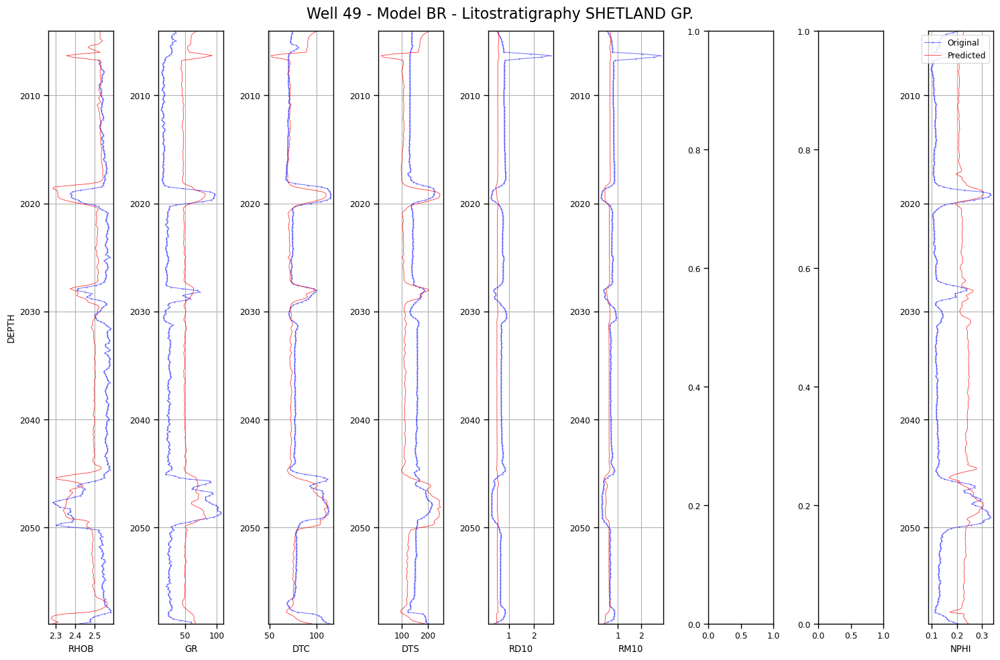

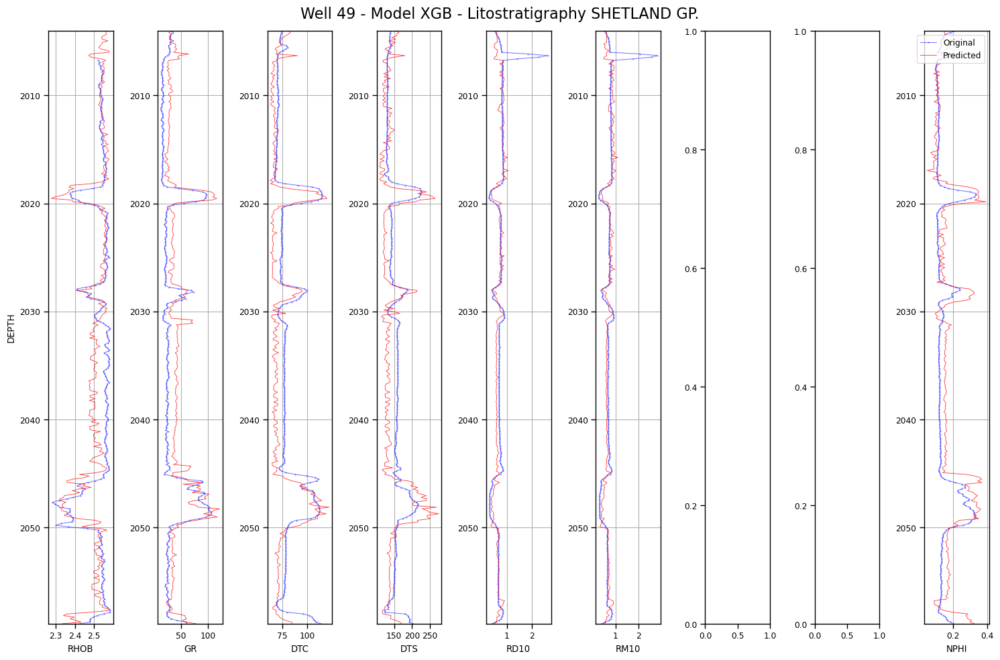

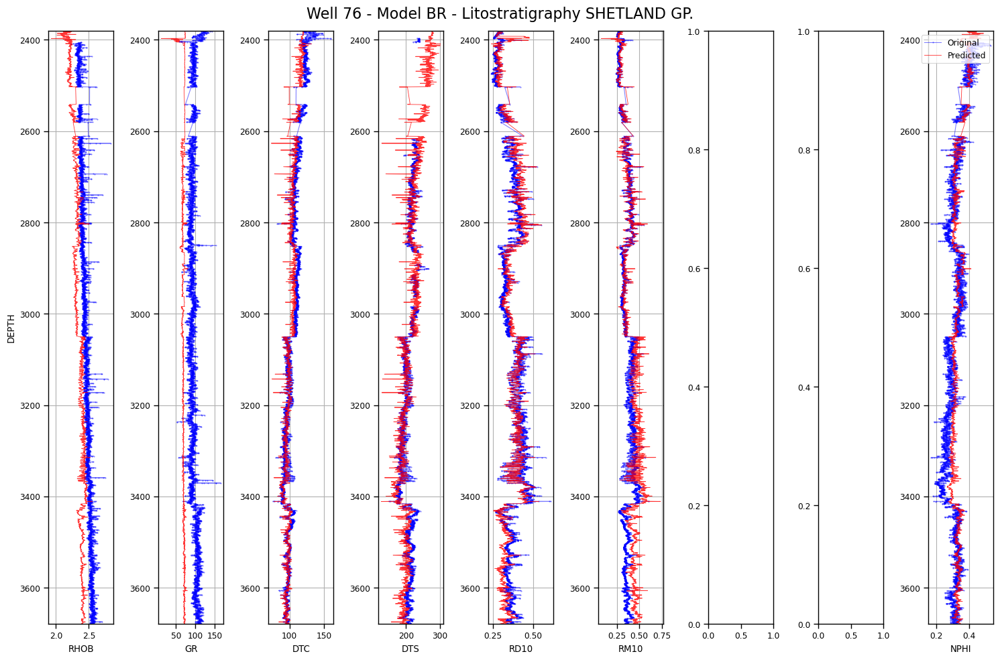

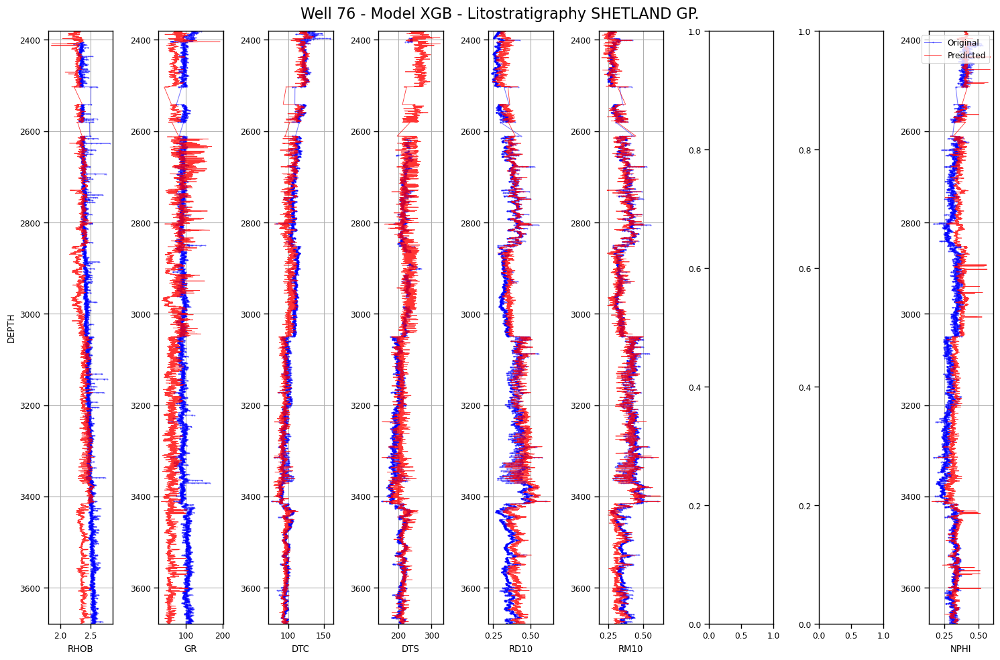

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


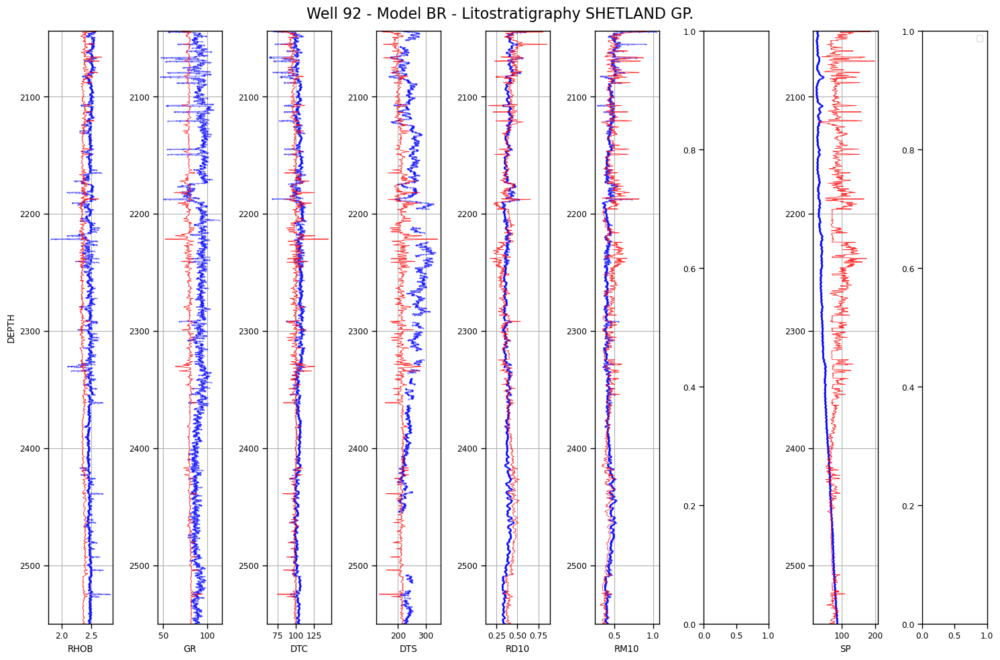

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


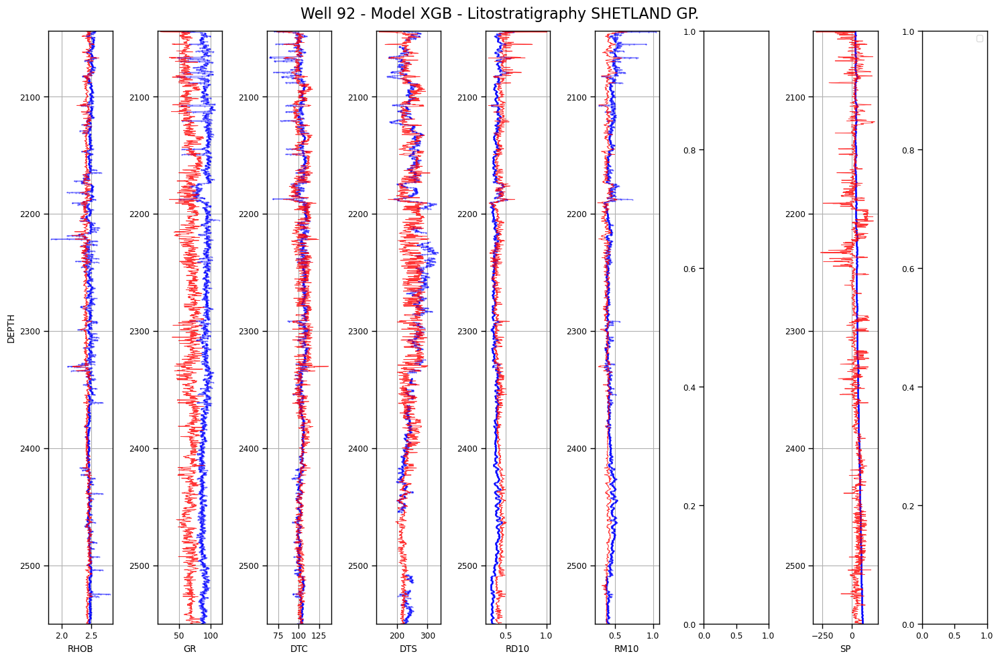

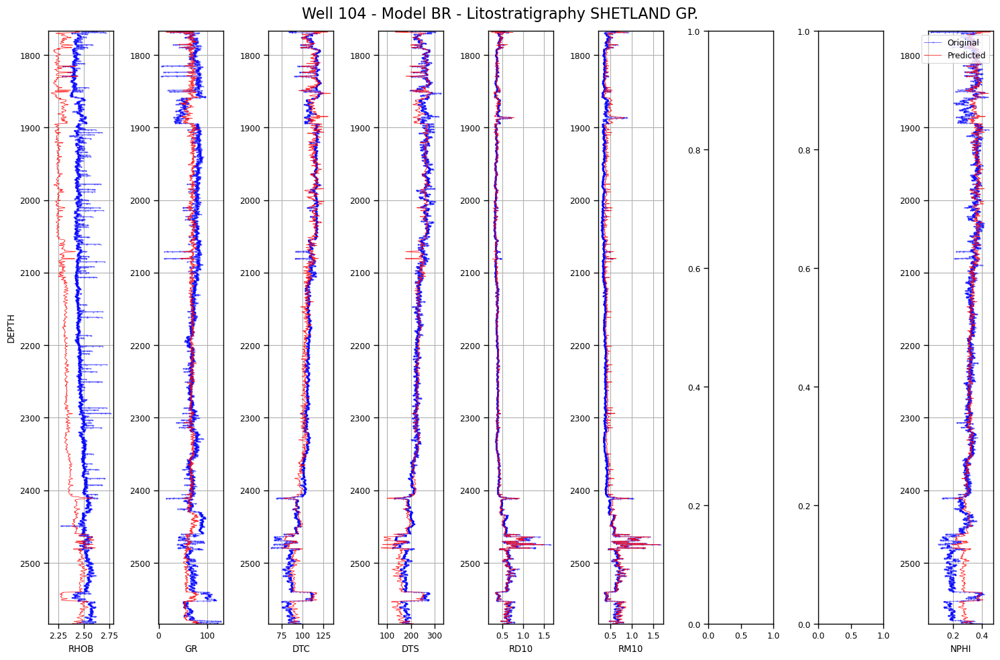

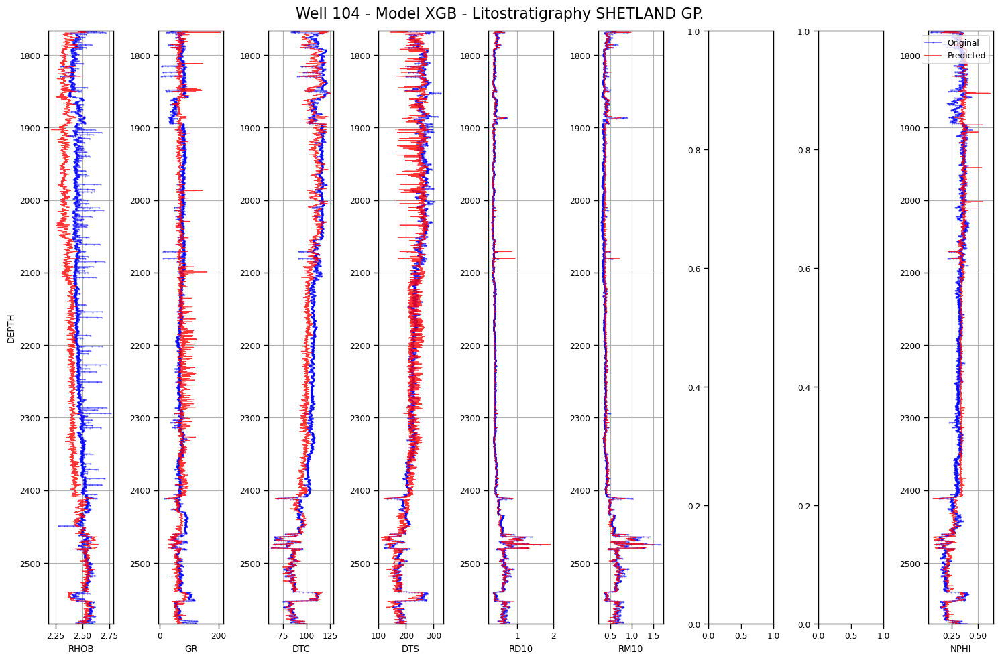

In [65]:
models = ['BR', 'XGB']

strats = ['SHETLAND GP.']

# test_wells_plot = [2, 6, 12, 16]
test_wells_plot = test_df['WELL'].unique()


for well in test_wells_plot:
    for model in models:
        for strati in strats:
            results_wells_strat(df=test_df, features=well_logs, name_well=well, model=model, lito_strat=strati) 

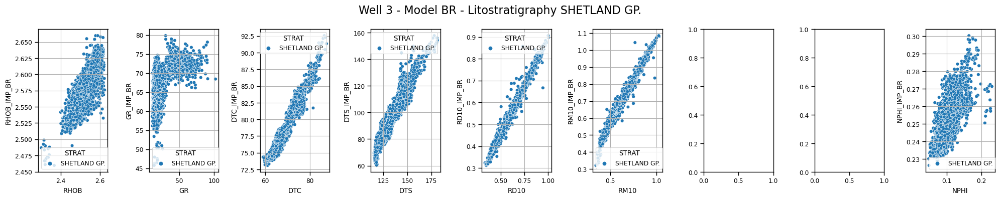

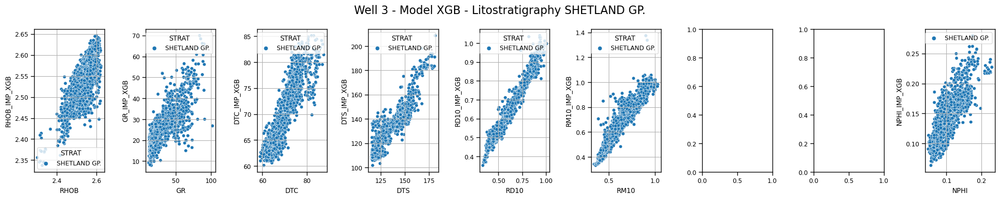

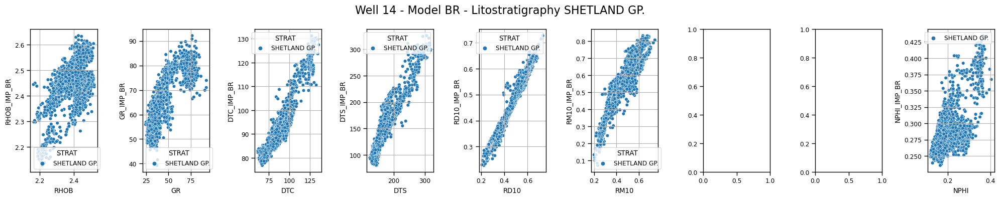

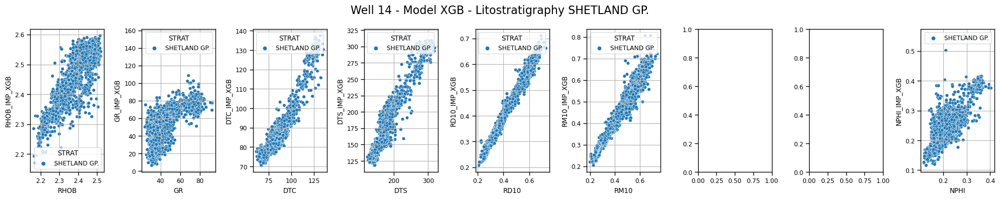

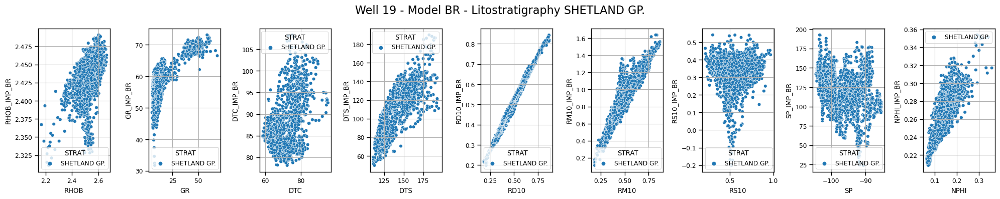

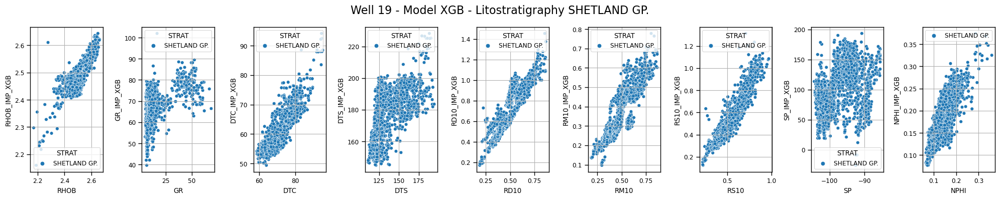

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


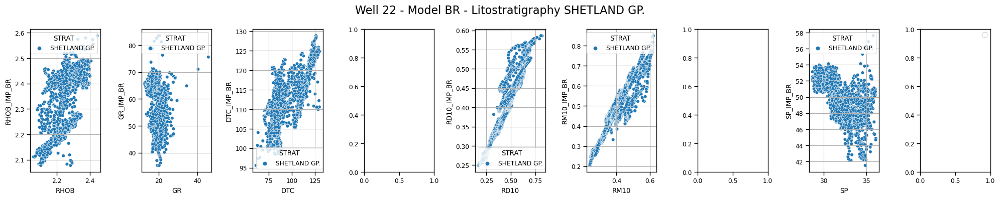

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


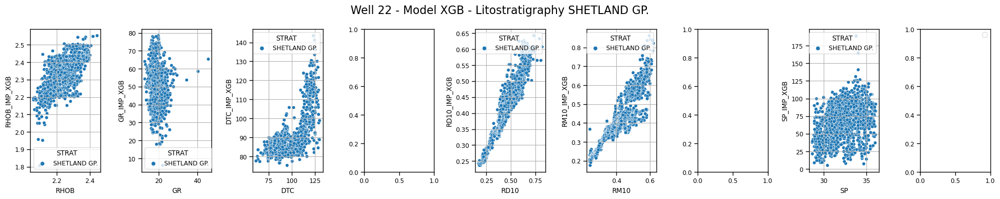

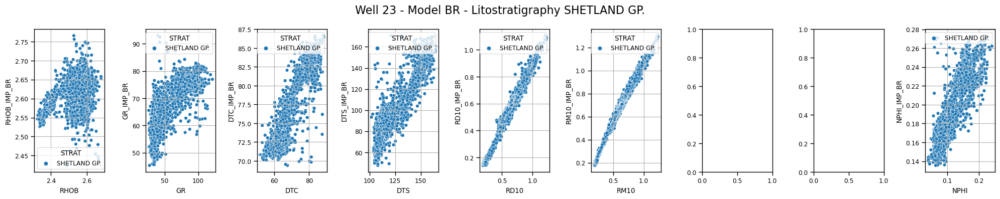

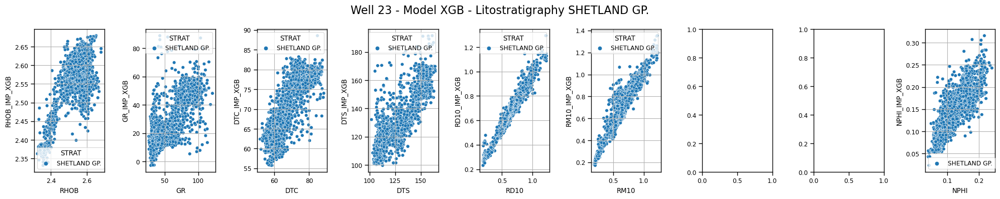

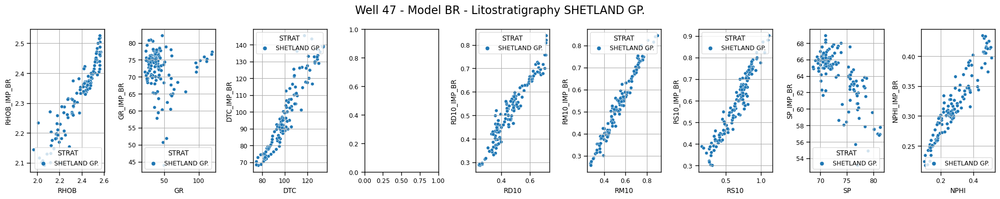

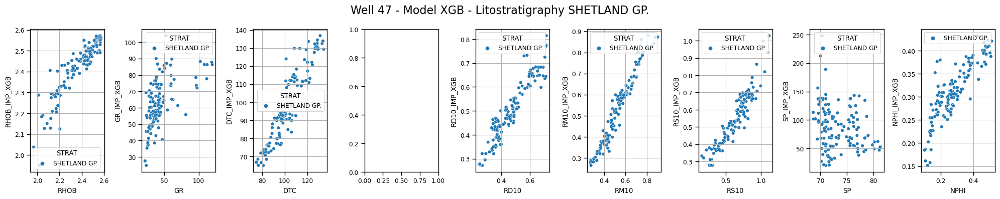

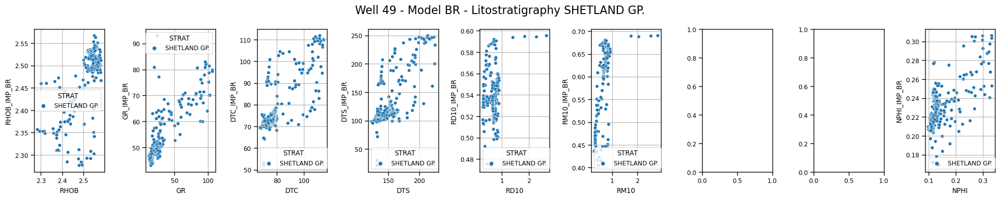

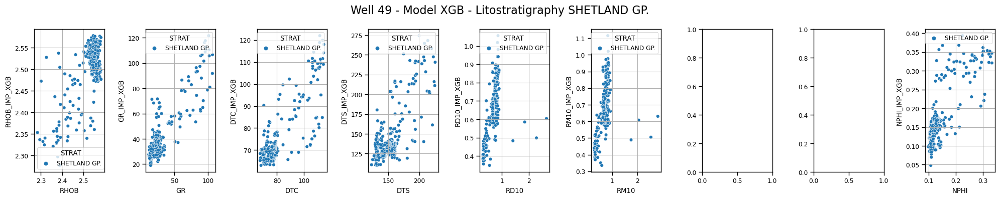

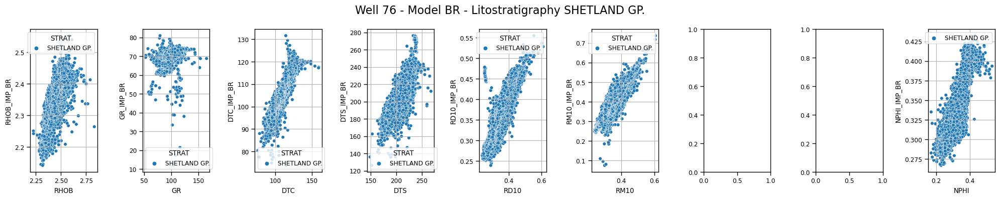

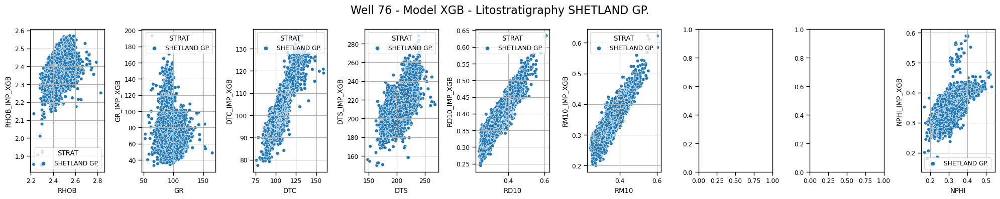

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


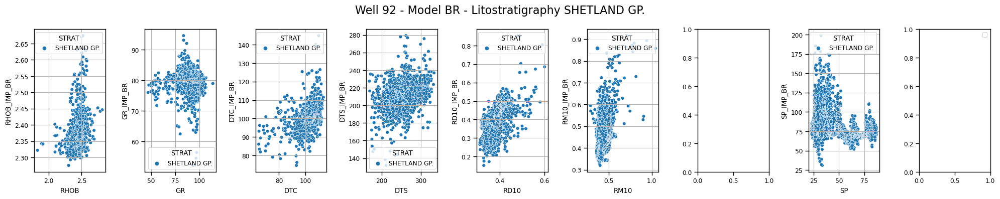

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


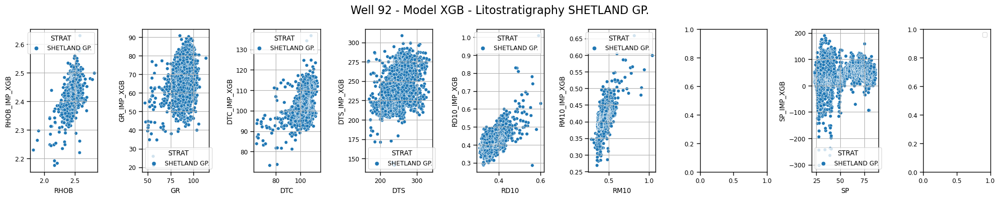

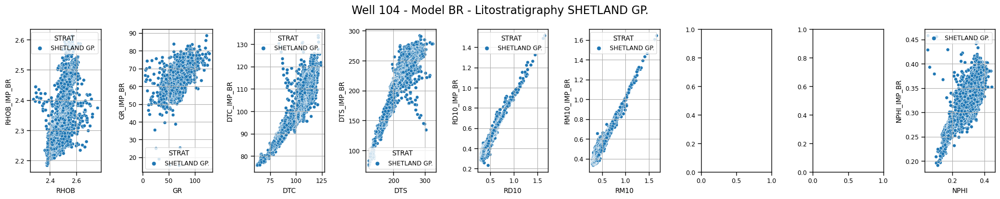

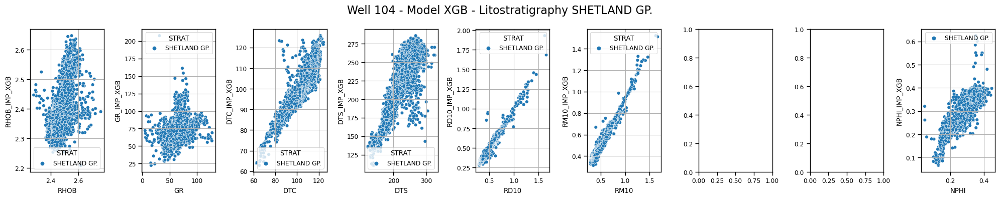

In [67]:
models = ['BR', 'XGB']

strats = ['SHETLAND GP.']

# test_wells_plot = [2, 6, 12, 16]
test_wells_plot = test_df['WELL'].unique()


for well in test_wells_plot:
    for model in models:
        for strati in strats:
            results_wells_strat_scatter(df=test_df, features=well_logs, name_well=well, model=model, lito_strat=strati) 